## Attempts at constructing a 2-dimensional Mapper Graph
The Mapper Algorithm is a useful tool in data analysis to produce readable graphs representing some higher dimensional data set. However a Mapper graph, as it was constucted in *Topological Methods for the Analysis of High Dimensional Data Sets and 3D Object Recognition* [Singh, et al.],  is only a 1-dimensional graph, but we believe there is a use for a Mapper graph which can output 2-dimensional cells as well to better visualize strong relationships within the data. 

Kepler Mapper already has documentation to produce a 1-dimensional Mapper graph, and so my goal is to extend this to constructing a 2-dimensional Mapper graph. 

### Overview of the Mapper Algorithm
Let $X$ be a data set which we think of as a finite compact metric space embeddable in some $\mathbb{R}^n$. For our algorithm we need the following tools:

1. A filter function $f\colon X\to \mathbb{R}^m$, where $m\leq n$. This filter function should be some function which reduces the dimension of the data set $X$. Typically $f$ is some projection of $X$ into $\mathbb{R}$ or $\mathbb{R}^2$. PCA is also a good choice of filter function. 
2. We use our filter function to view $f(X)\subset \mathbb{R}^m$ and we choose a (good open) cover $U=\{$ of $f(X)$. Currently in `kmapper` their cover is the standard hypercube cover which is extendable to any $\mathbb{R}^n$ and has hyperparameters *gain* and *resolution*. One goal is to create another cover based on [Overlapping Circles](https://en.wikipedia.org/wiki/Overlapping_circles_grid).
3. After choosing a cover on our data's image $f(X)$, we choose a clustering algorithm (typically `DBSCAN` from the `sklearn` package). With this, we take the preimage of each cover set, $f^{-1}(U_\alpha)$ and use are clustering algorithm to determine individual clusters $\bigcup_{i=1}^k C_{\alpha,i}=f^{-1}(U_\alpha)$.
4. Once the clusters are determined we want to find the nerve of the of the cover $\{f^{-1}(U_\alpha)\}$ of $X$. We note that each cluster $C_{\alpha,i}$ is a node in our Mapper graph. To find edges of our nerve we compute $C_{\alpha,i}\cap C_{\beta,j}$ for all pairs of clusters. For each pair such that $C_{\alpha,i}\cap C_{\beta,j}\neq \emptyset$ we connect these with an edge. 

This algorithm constructs a Mapper graph of the dataset $X$. With the following steps we can extend Mapper to become a 2 dimensional graph:

5. For each triple of clusters we check $$C_{\alpha,i}\cap C_{\beta,j}\cap C_{\gamma,k}\neq \emptyset.$$ Each triple with this property will add a 2-simplex $\sigma_{\alpha\beta\gamma}^{ijk}$ to our Mapper graph. 

In [3]:
import os
import sys
import time

module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path+"\\kepler-mapper")

In [39]:
import numpy as np
from collections import defaultdict
import kmapper as km
from kmapper import jupyter
from kmapper import nerve
from kmapper.plotlyviz import plotlyviz ## Plot Mapper
from kmapper.plotlyviz import (
    get_mapper_graph,
    plotly_graph)

from sklearn import datasets
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from itertools import combinations
import matplotlib.pyplot as plt
from itertools import combinations
import plotly.graph_objects as go

In [25]:
data, labels = datasets.make_circles(n_samples=10000, noise=0.05, factor=0.3)

# Initialize
mapper = km.KeplerMapper(verbose=0)

# Fit to and transform the data
lens = mapper.fit_transform(data, projection=[0,1])

# Create dictionary called 'simplicial_complex' with nodes, edges and meta-information
simplicial_complex = mapper.map(lens, X=data,
                                cover=km.Cover(n_cubes=10, perc_overlap=0.05),
                                nerve=nerve.GraphNerve(min_intersection=1))

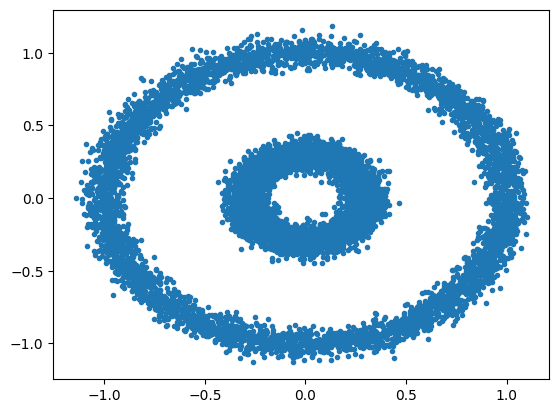

In [26]:
data
data_plot = plt.plot(data[:,0],data[:,1],'.')

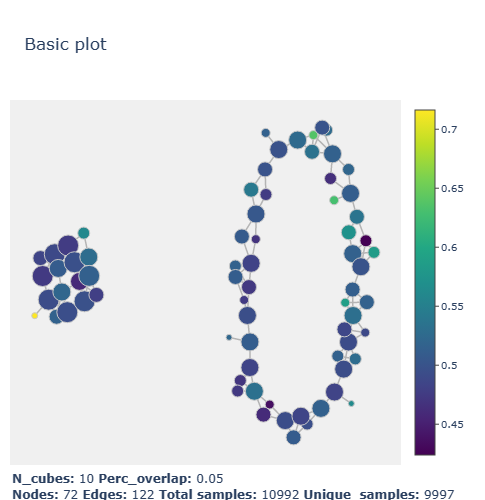

In [27]:
graph = plotlyviz(simplicial_complex, title="Basic plot")
graph.show()

In [28]:
# kmgraph is dictionary in a json representation.
# kmgraph keys are 'nodes' and 'links'
kmgraph, _, __ = get_mapper_graph(simplicial_complex)

# plotly_graph produces the traces for the plotly object.
# within this function it uses kmgraph to produce the mapper graph's
# coordinates and layout using the package iGraph.
traces = plotly_graph(kmgraph)
#print(kmgraph.keys())
#print(kmgraph['nodes'][0], '\n',kmgraph['links'][0])
#print(kmgraph['nodes'][6]['color'])

In [29]:
for k in kmgraph['links']:
    if k['source']>k['target']:
        print(k)       

In [24]:
## Find the two-simplices by hand since it is not in the module yet
def two_simplex(simplicial_complex):

    two_simplices = defaultdict(list)
    candidates = combinations(simplicial_complex["nodes"].keys(),3)
    for candidate in candidates:
        if len(set(simplicial_complex["nodes"][candidate[0]]).intersection(
            set(simplicial_complex["nodes"][candidate[1]]),
            set(simplicial_complex["nodes"][candidate[2]]))) > 0:
            two_simplices[candidate[0]] += [[candidate[1],candidate[2]]]
            
    return two_simplices

In [9]:
tri = two_simplex(simplicial_complex)
#print(kmgraph['nodes'][0]['id'])

In [30]:
# Redfine two_simplex using the km graph. This will make drawing the 
# mapper graph easier

def find_triangles(kmgraph):
    tri = {'triangles': []}
    candidates = combinations(kmgraph['nodes'],3)
    for i, candidate in enumerate(candidates):
        if len(set(candidate[0]['member_ids']).intersection(
            set(candidate[1]['member_ids']),
            set(candidate[2]['member_ids']))) > 0:
            t = {'id' : i,
                 'v0' : candidate[0]['id'],
                 'v1' : candidate[1]['id'],
                 'v2' : candidate[2]['id'],
                 'color' : np.average([candidate[i]['color'] for i in range(3)])}
            tri["triangles"].append(t)
    return tri

In [31]:
Tri = find_triangles(kmgraph)
print(len(Tri['triangles']))
#print(Tri['triangles'][5]['v0'])

53


We now have a function, `find triangles`, which finds all two-simplices in our mapper graph and labels them via each node's id. As coordinates our found with node_id, we should be able to use this to find coordinates for our graph. 

Due to orientation issues with the `fill` argument in `Plotly`, we have to have at least four separate traces. This is so we can properly fill the case where we have four vertices: 0, 1, 2, 3 with four simplices: (0,1,2), (0,1,3), (0,2,3), and (1,2,3).
Having any combination of these traces with the `fill='toself'` leads to incorrect filling. 

If requested I will add an example to show this.

In [10]:
 def find_coords(Tri, kmgraph):
    traces = plotly_graph(kmgraph)
    nodetrace = traces[1]
    tx1, tx2, tx3, tx4 = [], [], [], []
    ty1, ty2, ty3, ty4 = [], [], [], []
    for i in range(len(Tri['triangles'])):
        xcoords = [nodetrace['x'][Tri['triangles'][i]['v0']], 
                   nodetrace['x'][Tri['triangles'][i]['v1']],
                   nodetrace['x'][Tri['triangles'][i]['v2']],
                   None]
        ycoords = [nodetrace['y'][Tri['triangles'][i]['v0']],
                   nodetrace['y'][Tri['triangles'][i]['v1']],
                   nodetrace['y'][Tri['triangles'][i]['v2']],
                   None]
        if len(set(tx1).intersection(set(xcoords))) < 3 and \
        len(set(ty1).intersection(set(ycoords))) < 3:
            tx1.extend(xcoords)
            ty1.extend(ycoords)
        
        elif len(set(tx2).intersection(set(xcoords))) < 3 and \
        len(set(ty2).intersection(set(ycoords))) < 3:
            tx2.extend(xcoords)
            ty2.extend(ycoords)
            
        elif len(set(tx3).intersection(set(xcoords))) < 3 and \
        len(set(ty3).intersection(set(ycoords))) < 3:
            tx3.extend(xcoords)
            ty3.extend(ycoords)
            
        elif len(set(tx4).intersection(set(xcoords))) < 3 and \
        len(set(ty4).intersection(set(ycoords))) < 3:
            tx4.extend(xcoords)
            ty4.extend(ycoords)
        else:
            print('Were gonna need more traces')
            break
            
## We will worry about color later, for now just get this to run     
    triangle_trace1 = dict(
        type="scatter",
        x=tx1,
        y=ty1,
        fill= 'toself'
        )
    triangle_trace2 = dict(
        type="scatter",
        x=tx2,
        y=ty2,
        fill= 'toself'
        )
    triangle_trace3 = dict(
        type="scatter",
        x=tx3,
        y=ty3,
        fill= 'toself'
        )
    triangle_trace4 = dict(
        type="scatter",
        x=tx4,
        y=ty4,
        fill= 'toself'
        )
    return [triangle_trace1, triangle_trace2, triangle_trace3, triangle_trace4]

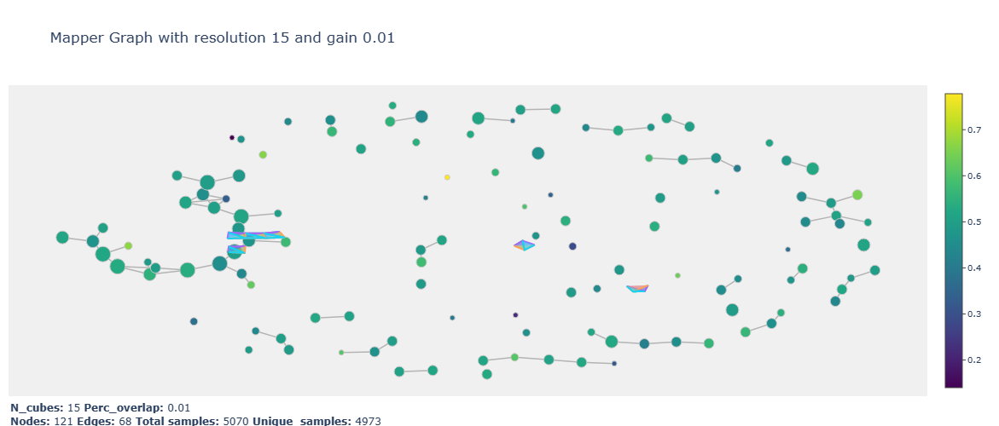

In [27]:
works = find_coords(Tri,kmgraph)
# Now with traces of our 2-simplices we can add them to the Mapper figure.
for i in range(len(works)):
    graph.add_trace(works[i])
graph.show()

Above we see that our construction of 2-simplices worked! Now my next goal is to get the color of the 2-simplices to be the average color of the nodes it is connencting. For this we will have to take the color scale given to us in the original KeplerMapper construction.

Next we also need to run some tests, generating a lot of graphs to see if there are some cracks in the `find_coords`. 

After this we should be able to append this to the `Kepler Mapper` module. This would be an awesome accomplishment. 

Below is some experiments on resolution and gain for mapper. We can find more in depth details from the paper [Statistical Analysis and Parameter Selection for Mapper](https://arxiv.org/pdf/1706.00204.pdf), written by Carriere, Michel, and Oudot.
Additionally we test how long it takes to produce the 2-mapper graph across the changes of resolution and gain.

This Mapper graph has 12 two-simplices
Were gonna need more traces


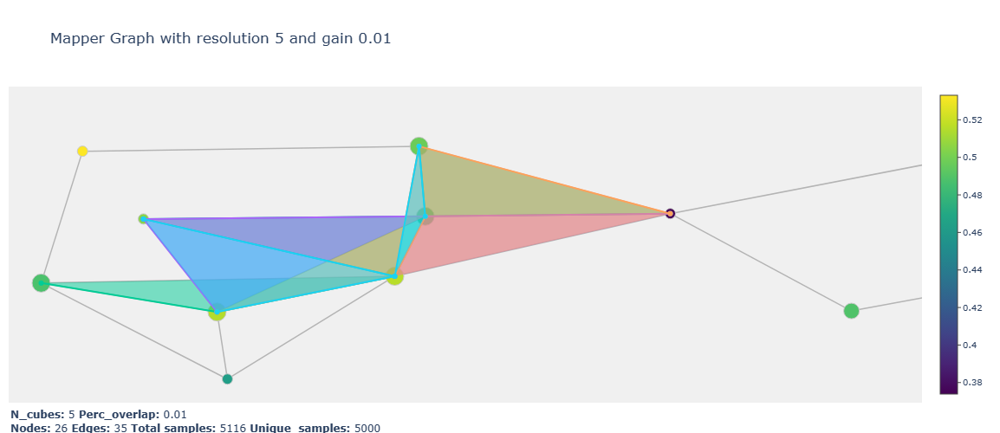

This Mapper graph has 8 two-simplices


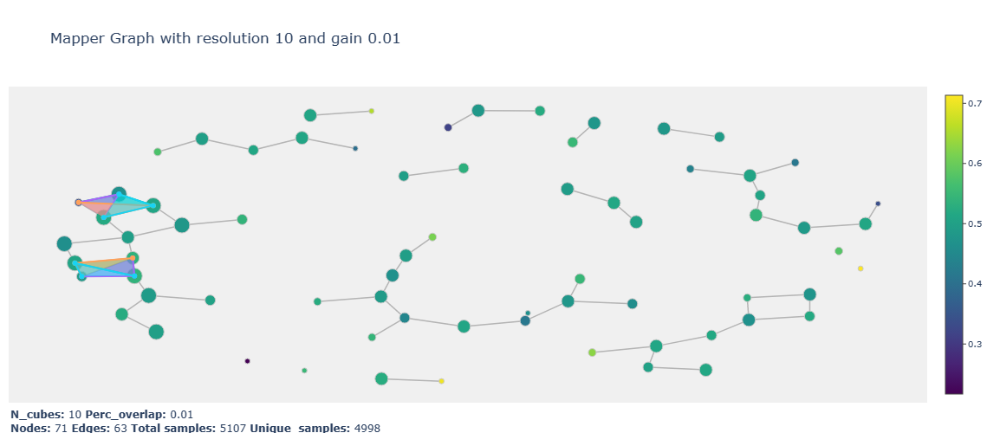

This Mapper graph has 4 two-simplices


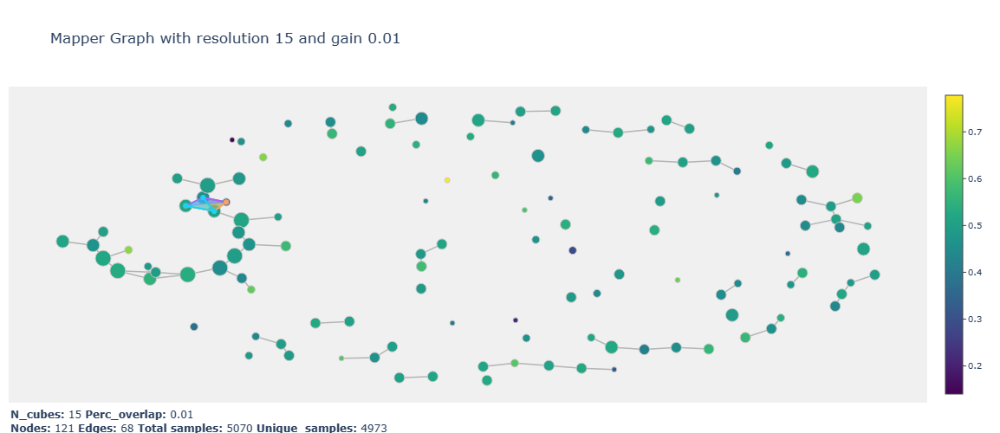

This Mapper graph has 0 two-simplices
This Mapper graph has 0 two-simplices
This Mapper graph has 5 two-simplices


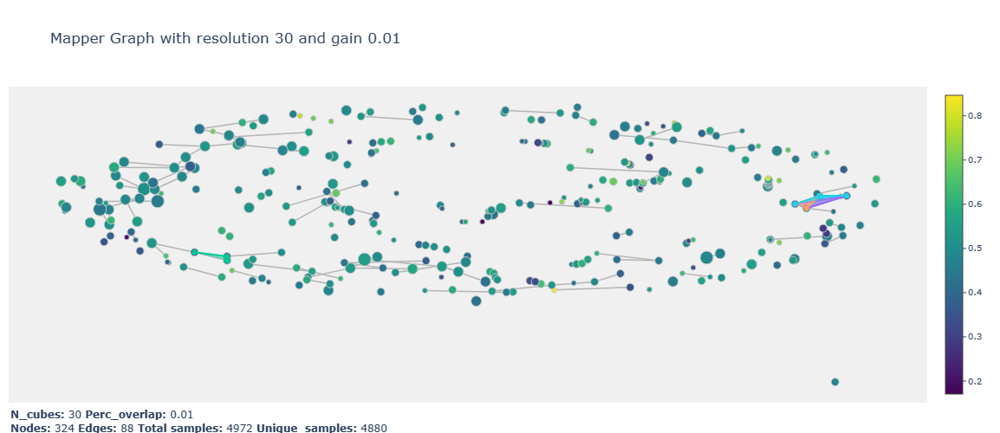

This Mapper graph has 28 two-simplices
Were gonna need more traces


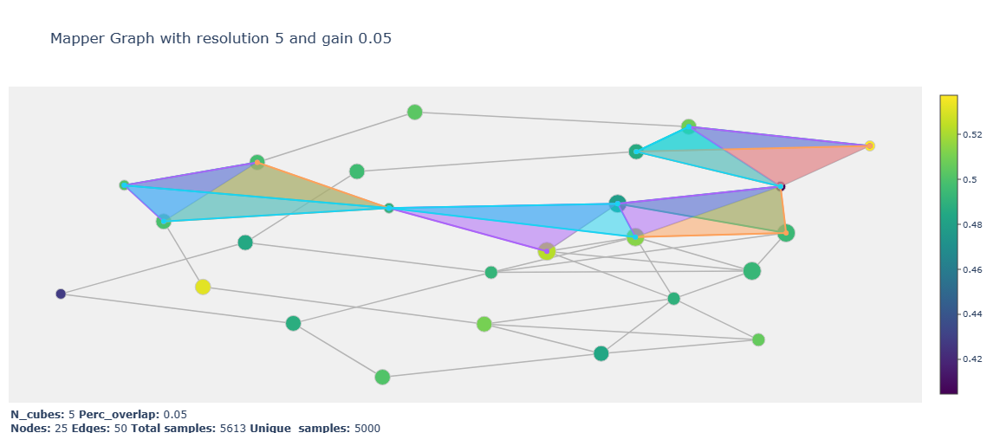

This Mapper graph has 24 two-simplices


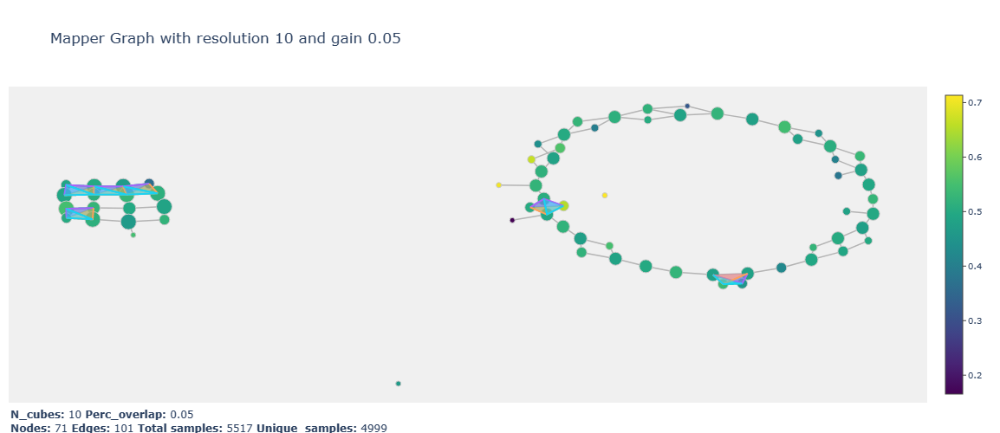

This Mapper graph has 63 two-simplices
Were gonna need more traces


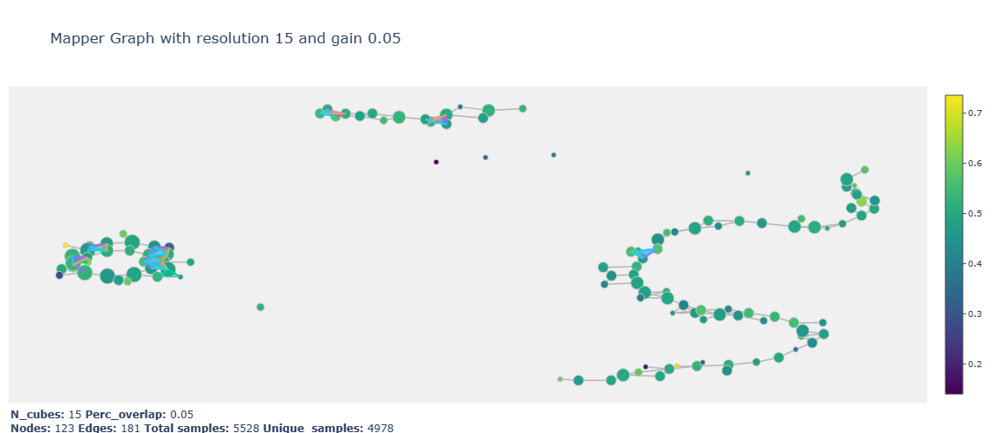

This Mapper graph has 49 two-simplices
Were gonna need more traces


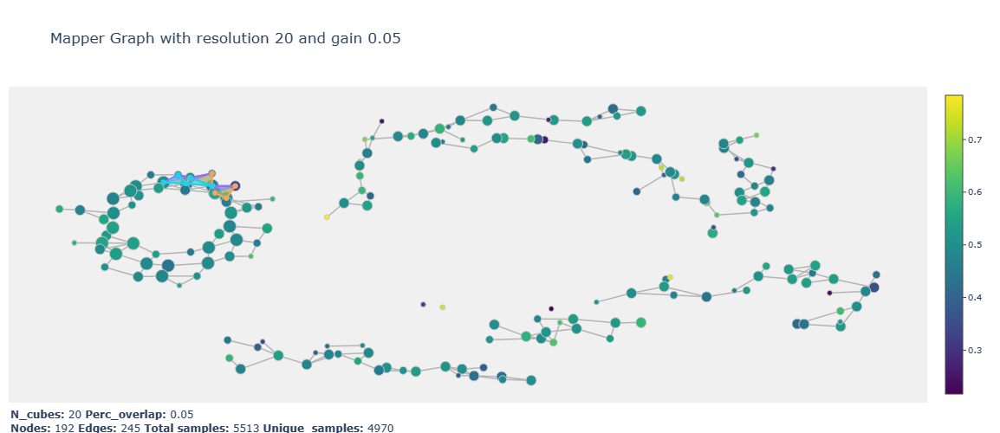

This Mapper graph has 57 two-simplices
Were gonna need more traces


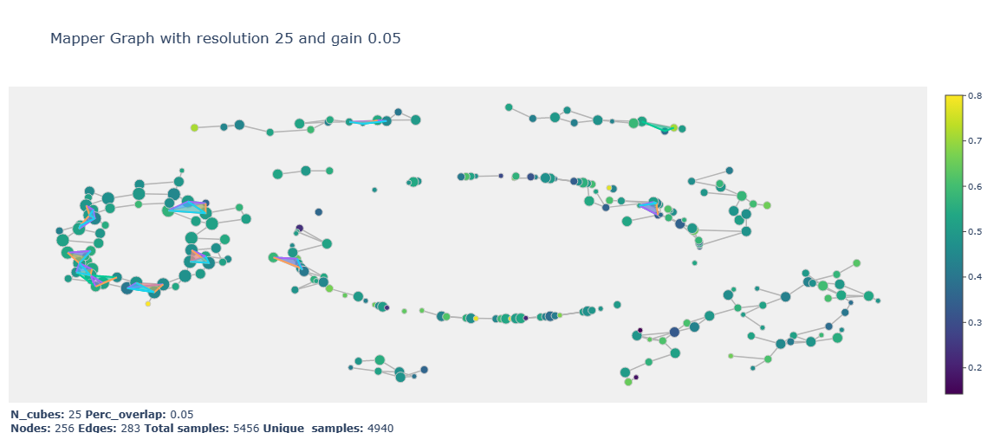

This Mapper graph has 82 two-simplices
Were gonna need more traces


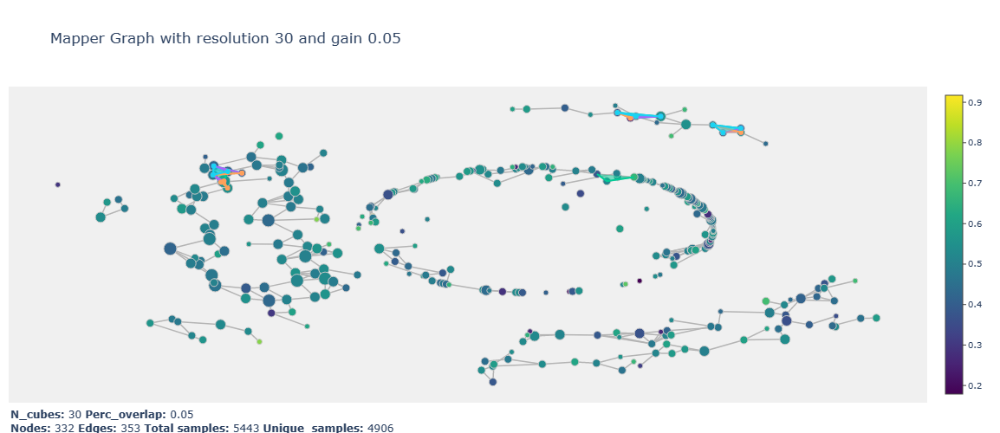

This Mapper graph has 32 two-simplices
Were gonna need more traces


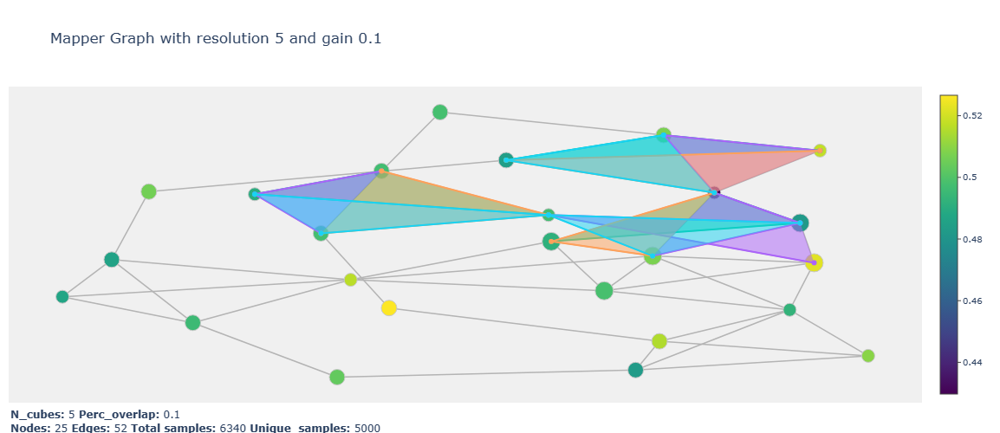

This Mapper graph has 85 two-simplices
Were gonna need more traces


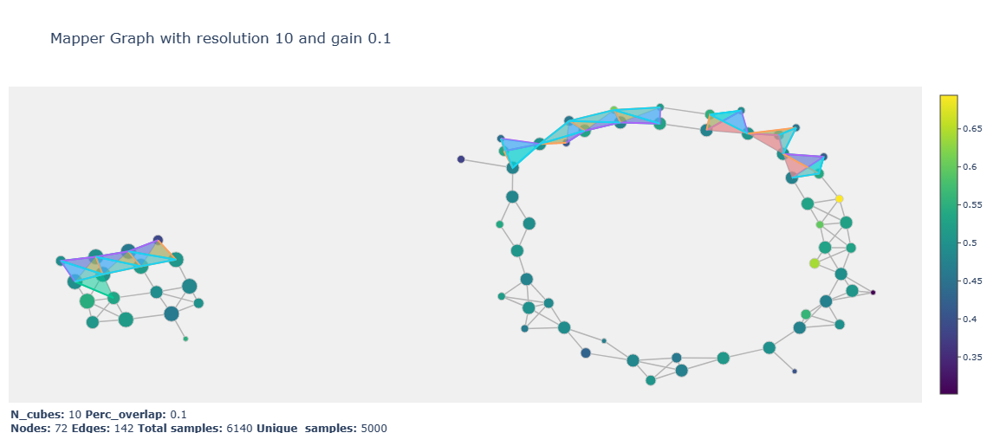

This Mapper graph has 148 two-simplices
Were gonna need more traces


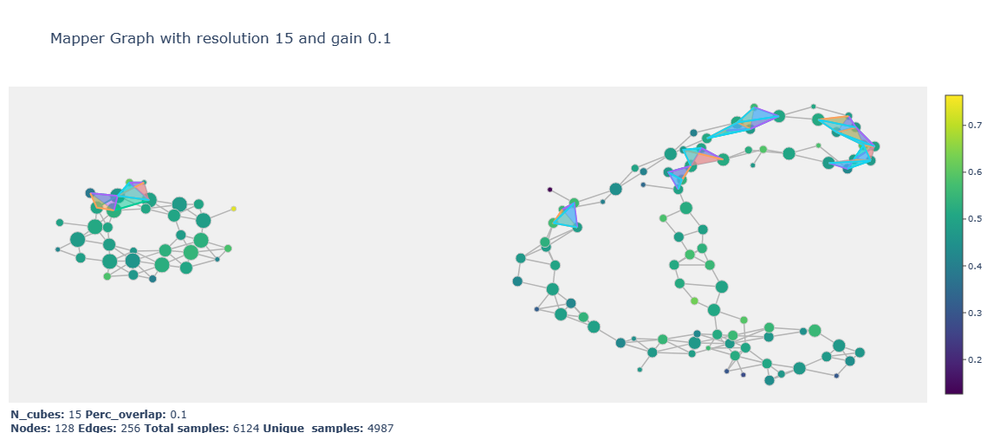

This Mapper graph has 157 two-simplices
Were gonna need more traces


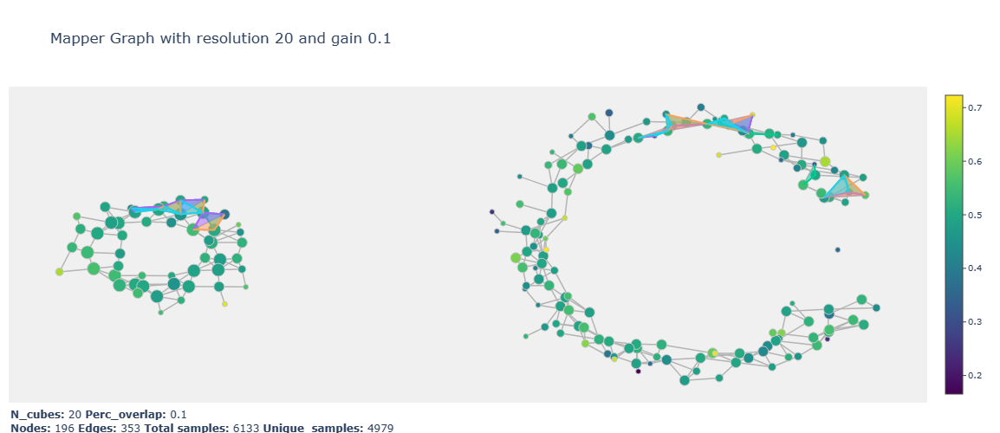

This Mapper graph has 176 two-simplices
Were gonna need more traces


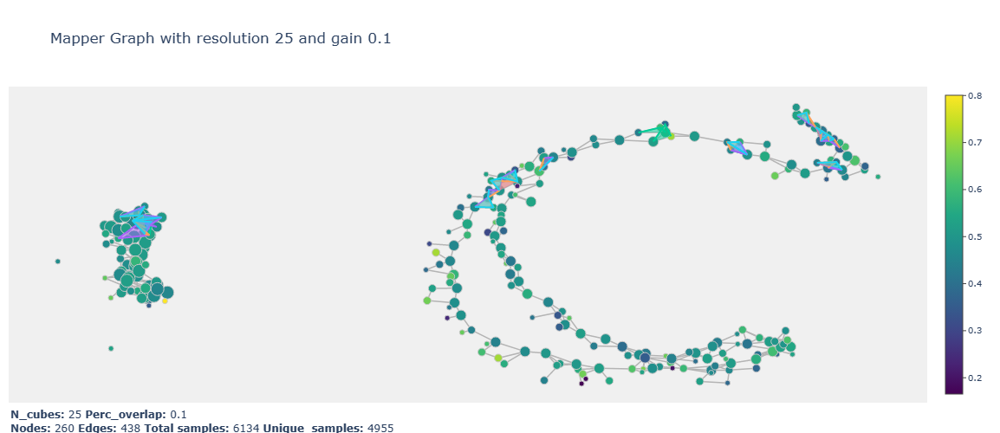

This Mapper graph has 224 two-simplices
Were gonna need more traces


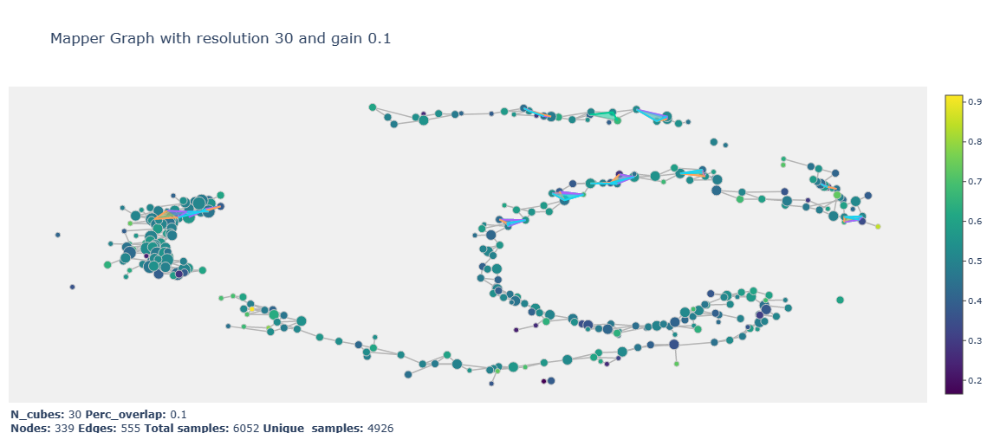

This Mapper graph has 32 two-simplices
Were gonna need more traces


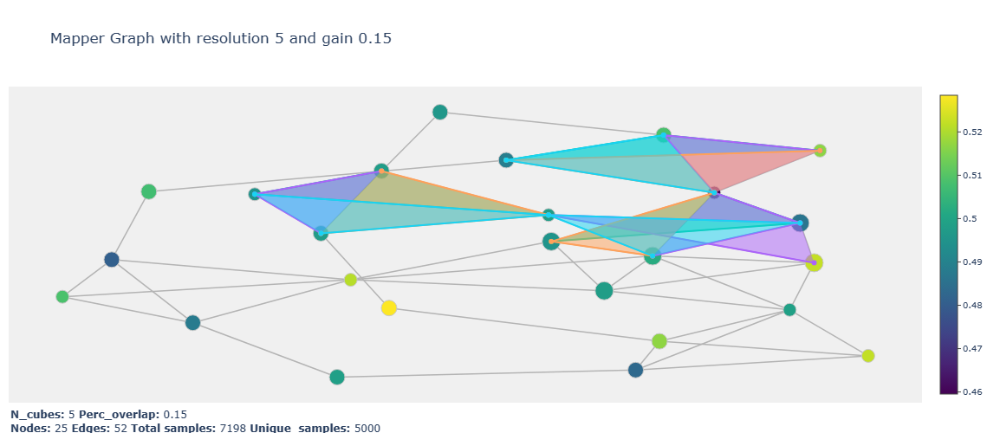

This Mapper graph has 107 two-simplices
Were gonna need more traces


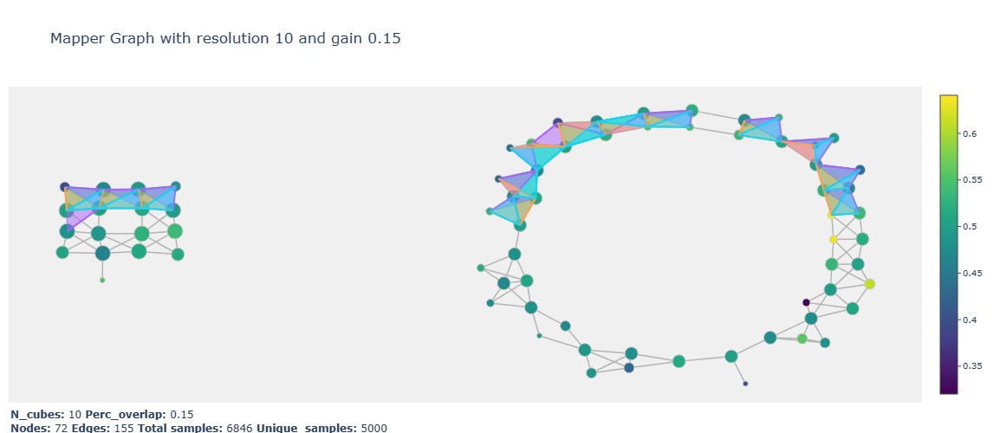

This Mapper graph has 247 two-simplices
Were gonna need more traces


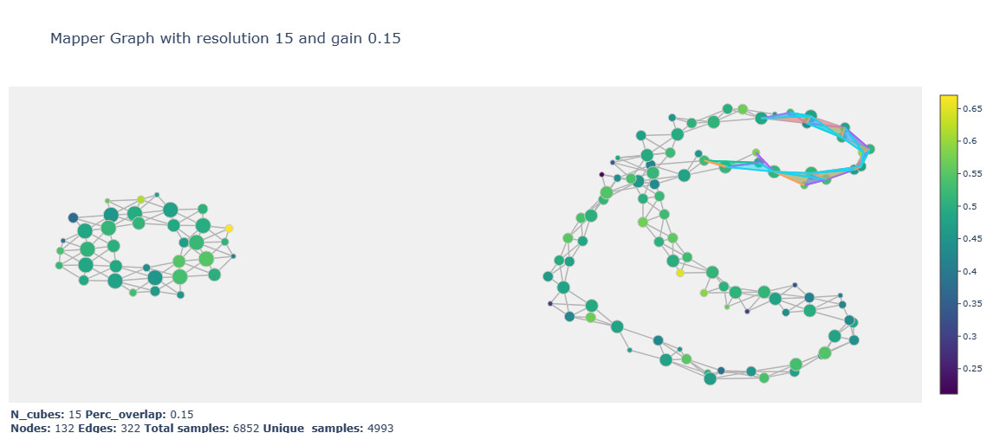

This Mapper graph has 297 two-simplices
Were gonna need more traces


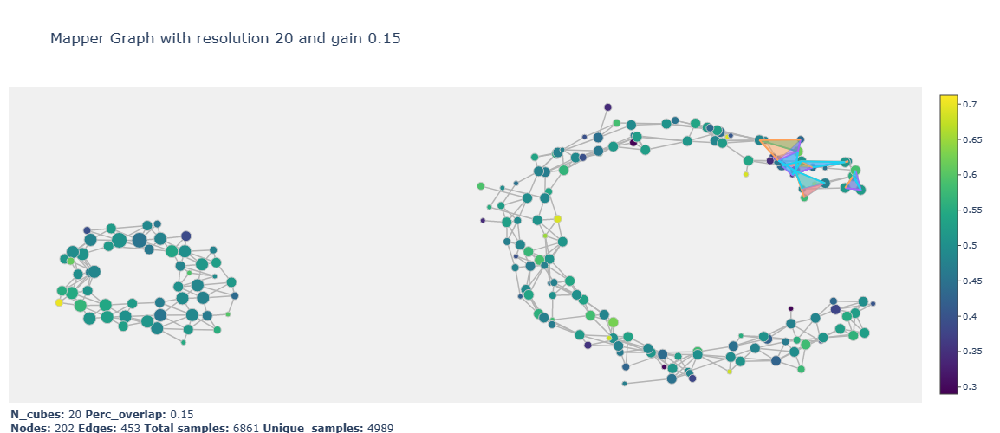

This Mapper graph has 357 two-simplices
Were gonna need more traces


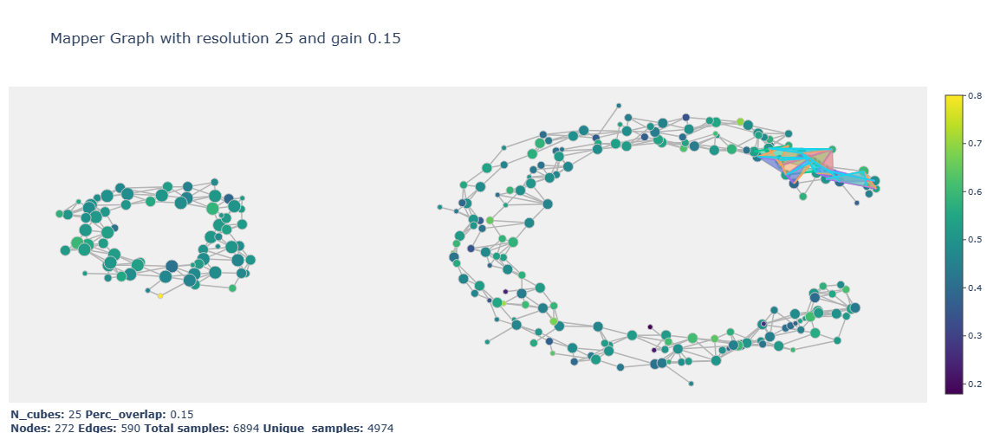

This Mapper graph has 361 two-simplices
Were gonna need more traces


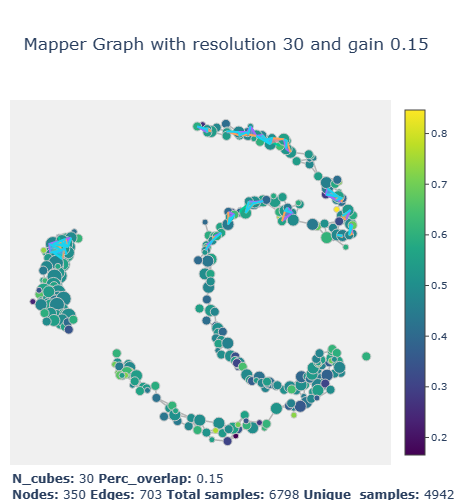

This Mapper graph has 32 two-simplices
Were gonna need more traces


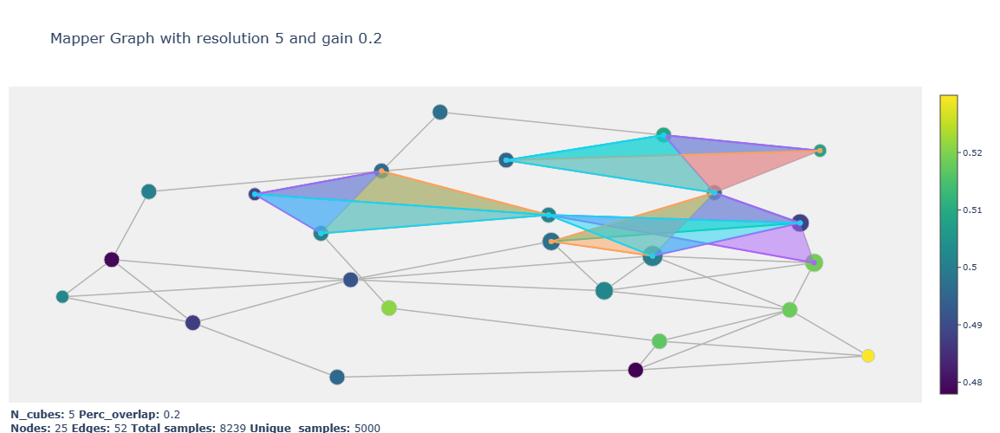

This Mapper graph has 127 two-simplices
Were gonna need more traces


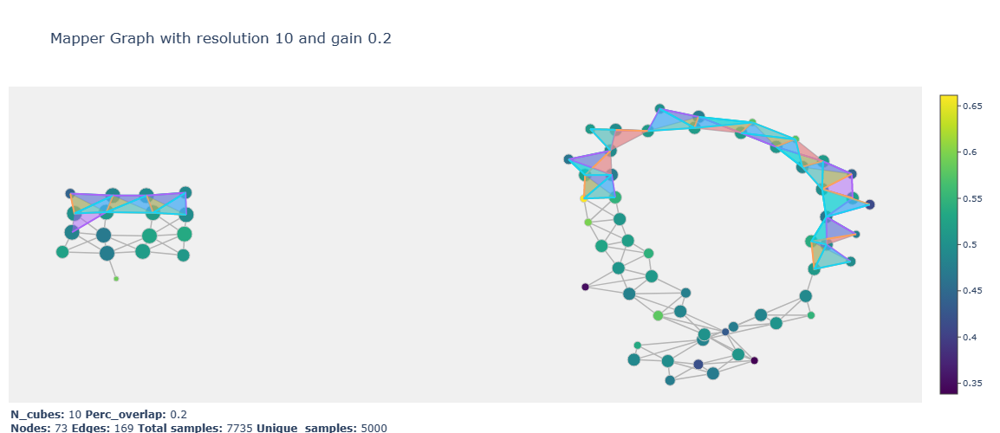

This Mapper graph has 274 two-simplices
Were gonna need more traces


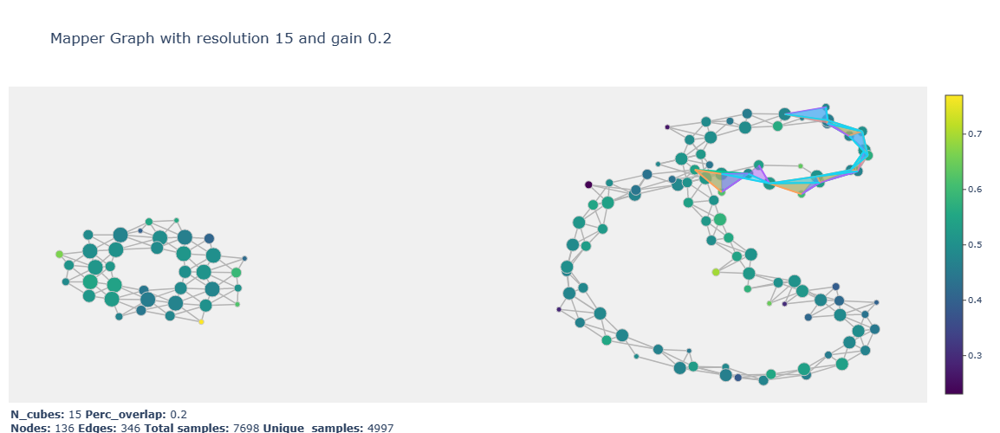

This Mapper graph has 419 two-simplices
Were gonna need more traces


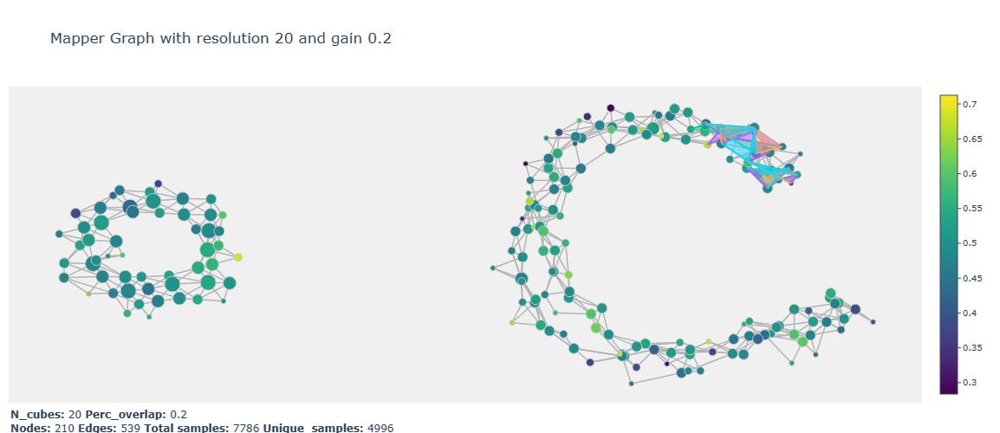

This Mapper graph has 497 two-simplices
Were gonna need more traces


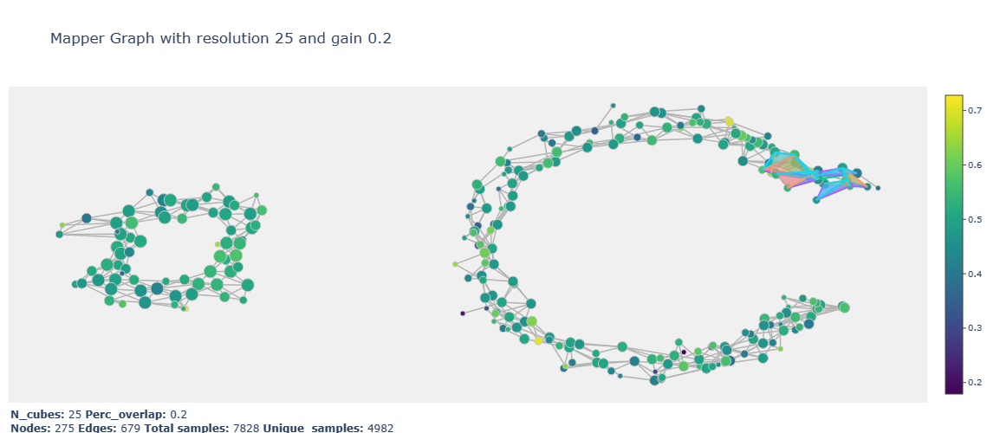

This Mapper graph has 591 two-simplices
Were gonna need more traces


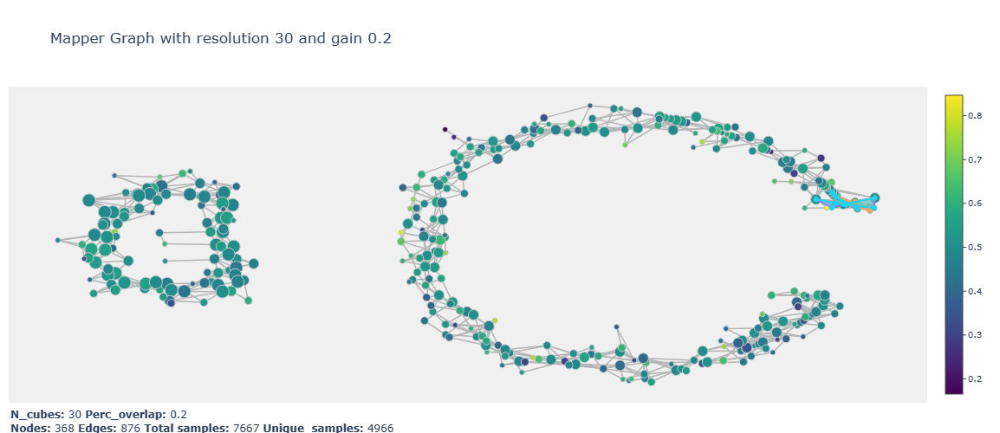

This Mapper graph has 32 two-simplices
Were gonna need more traces


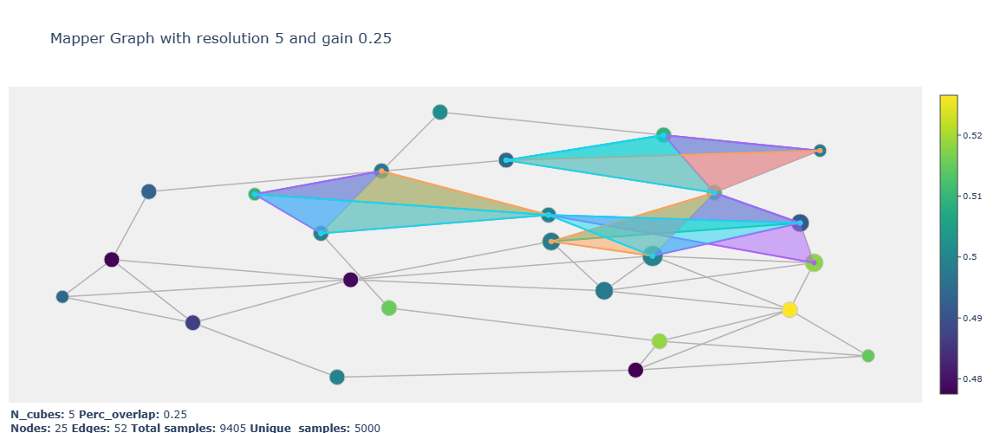

This Mapper graph has 138 two-simplices
Were gonna need more traces


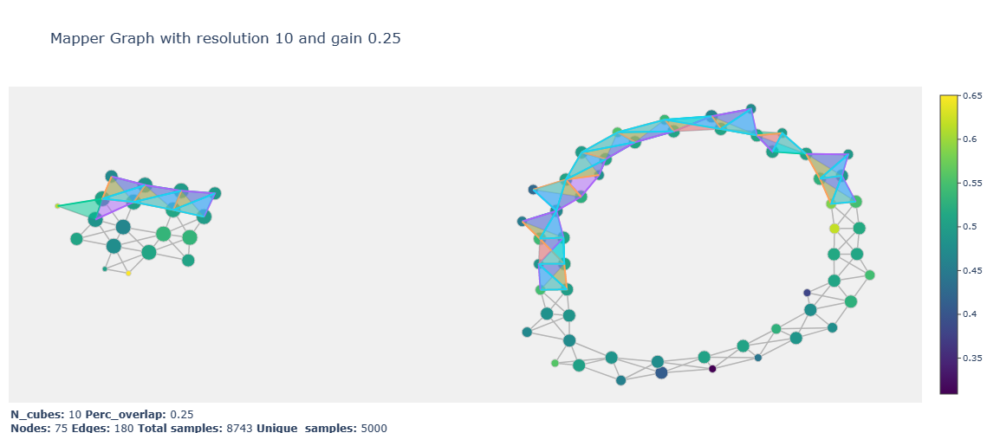

This Mapper graph has 298 two-simplices
Were gonna need more traces


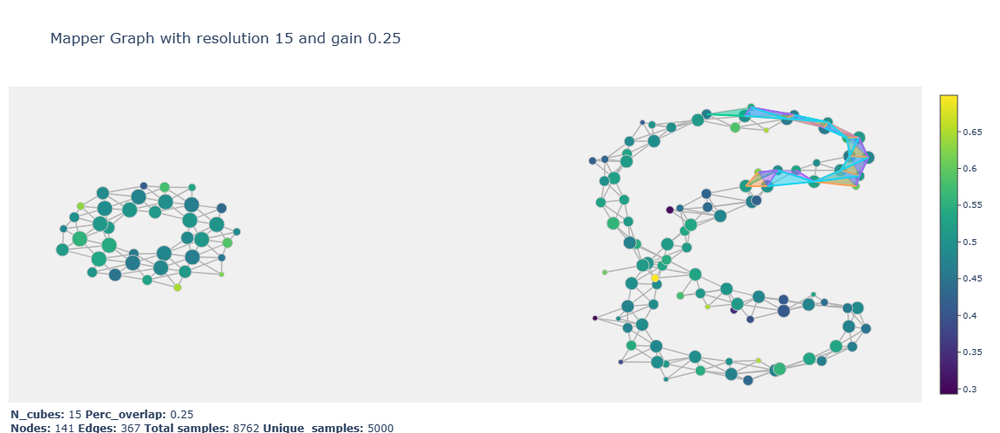

This Mapper graph has 480 two-simplices
Were gonna need more traces


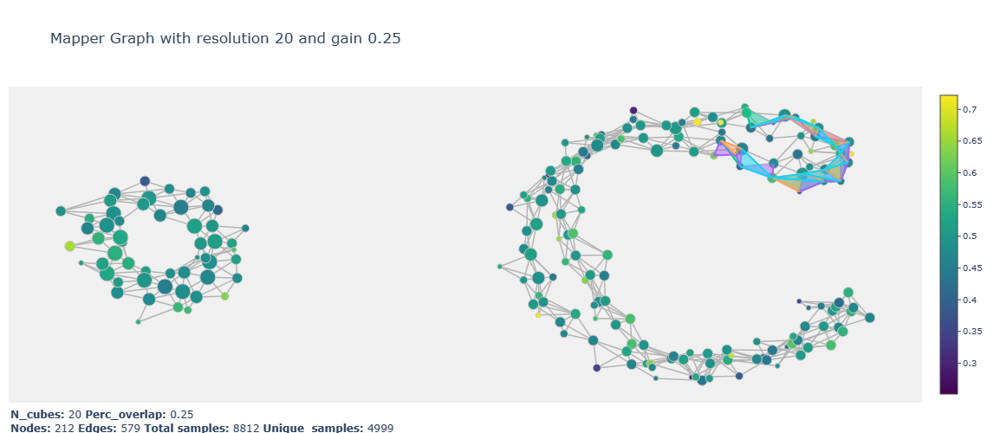

This Mapper graph has 620 two-simplices
Were gonna need more traces


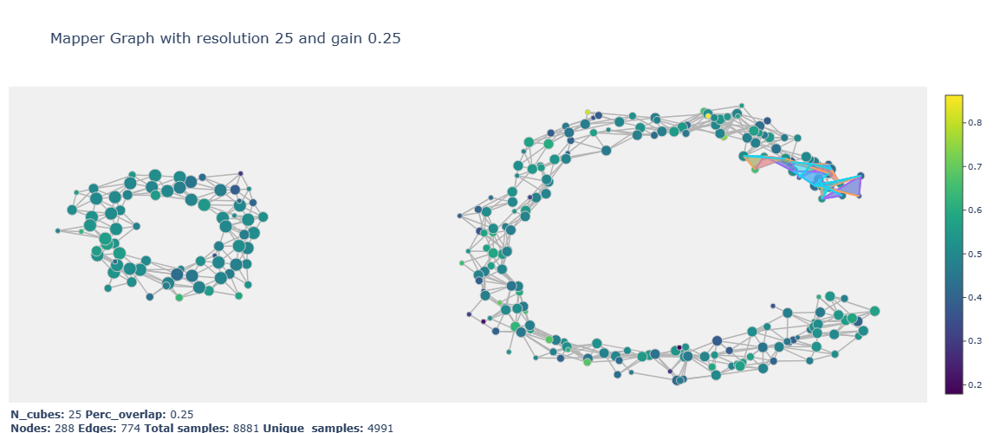

This Mapper graph has 839 two-simplices
Were gonna need more traces


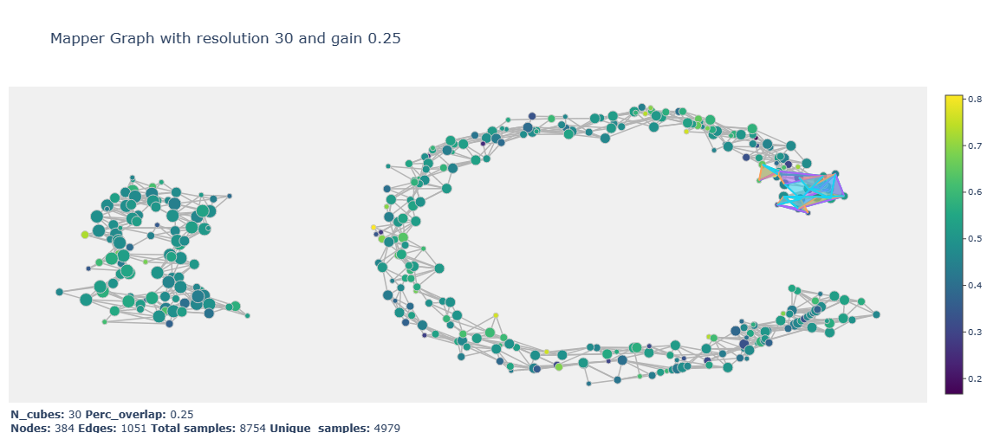

This Mapper graph has 32 two-simplices
Were gonna need more traces


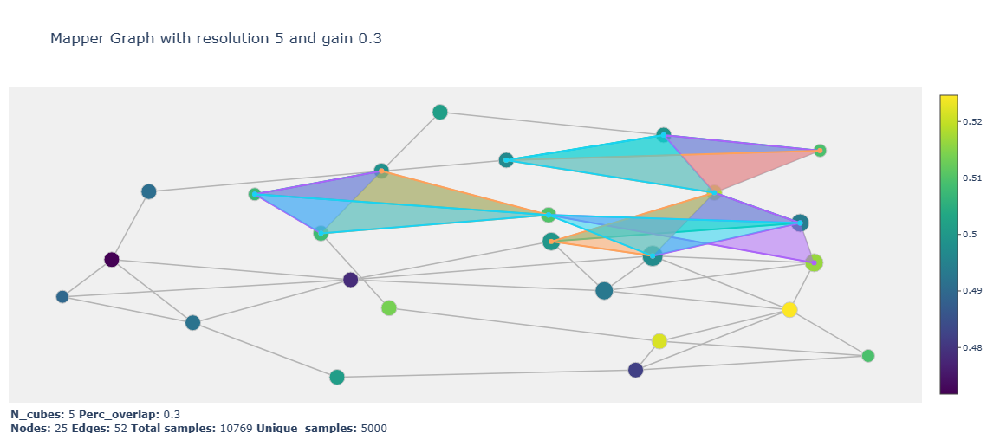

This Mapper graph has 150 two-simplices
Were gonna need more traces


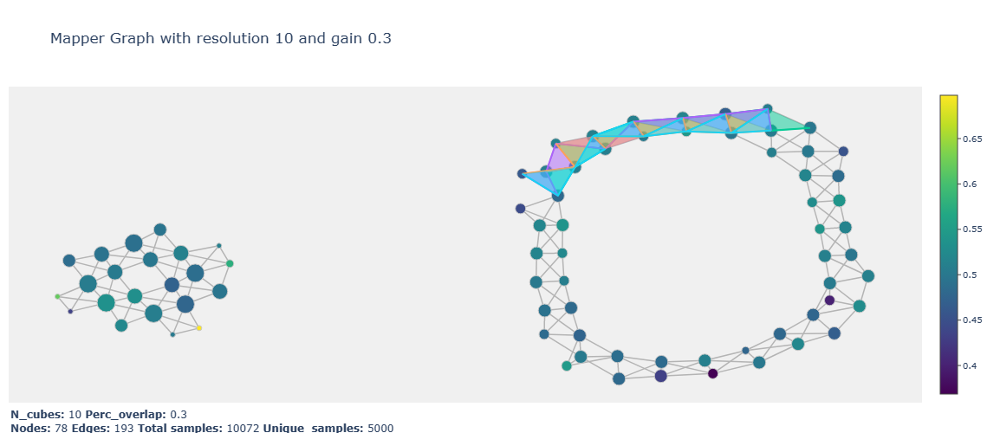

This Mapper graph has 316 two-simplices
Were gonna need more traces


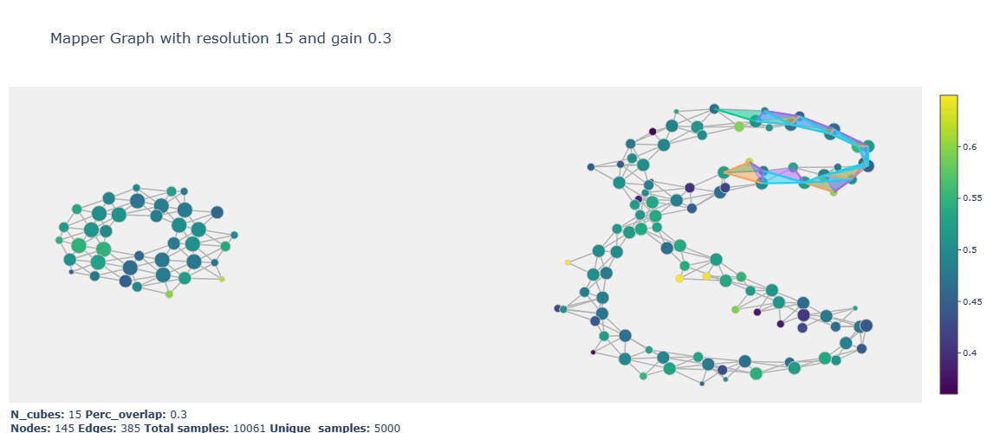

This Mapper graph has 521 two-simplices
Were gonna need more traces


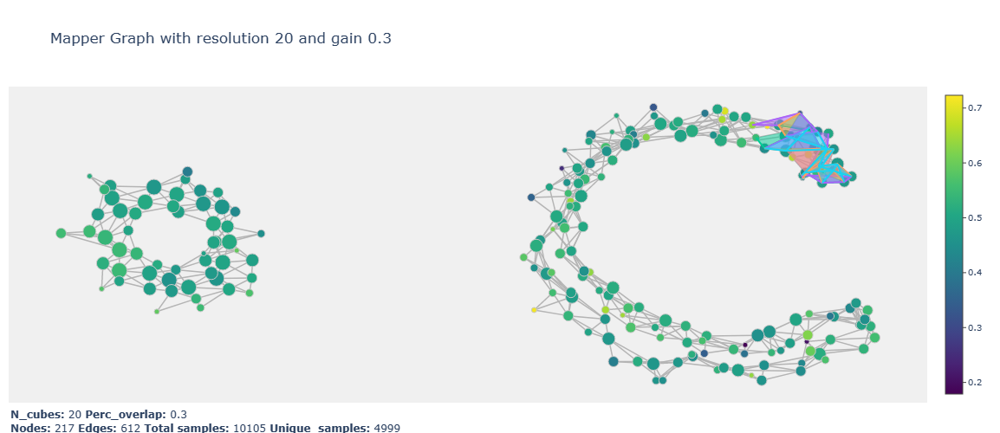

This Mapper graph has 733 two-simplices
Were gonna need more traces


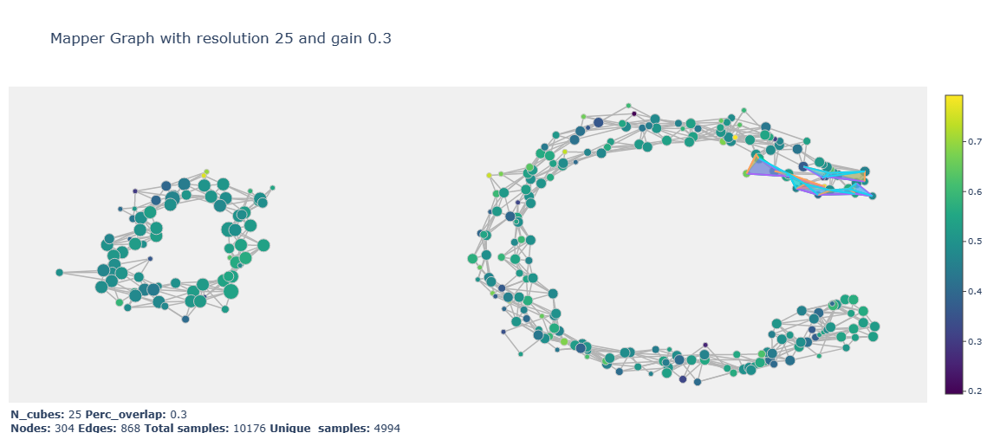

This Mapper graph has 980 two-simplices
Were gonna need more traces


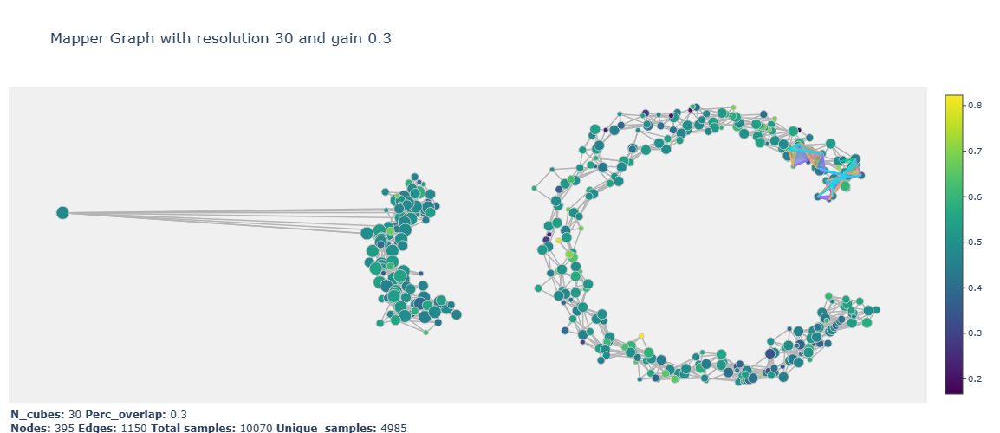

This Mapper graph has 60 two-simplices
Were gonna need more traces


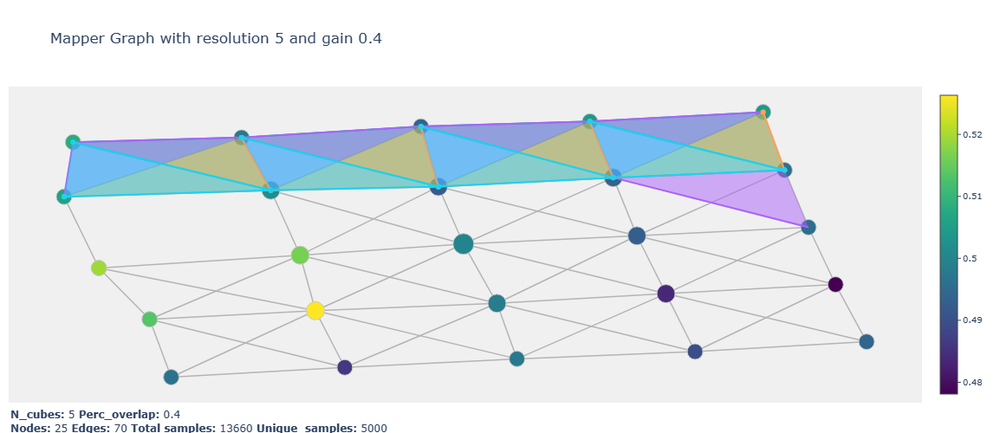

This Mapper graph has 204 two-simplices
Were gonna need more traces


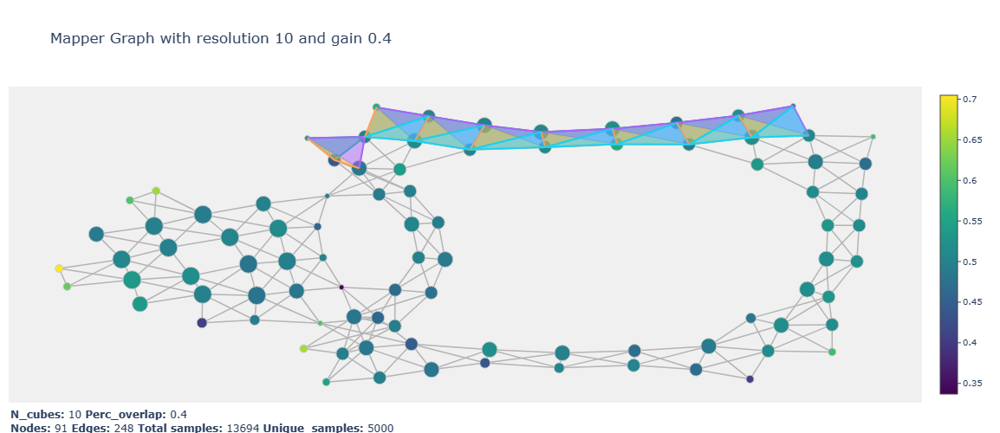

This Mapper graph has 377 two-simplices
Were gonna need more traces


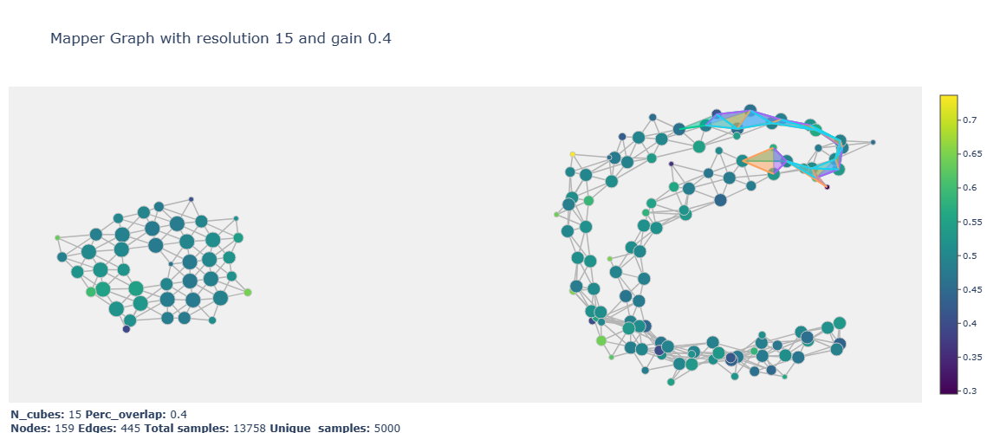

This Mapper graph has 632 two-simplices
Were gonna need more traces


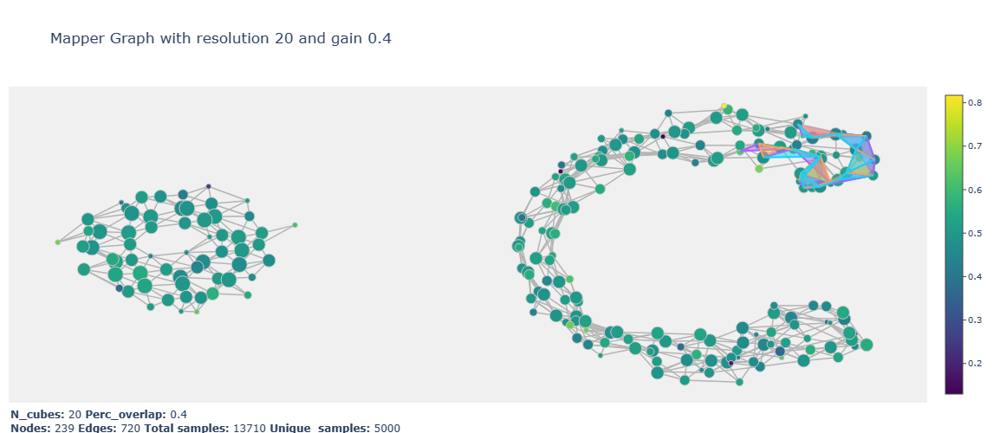

This Mapper graph has 896 two-simplices
Were gonna need more traces


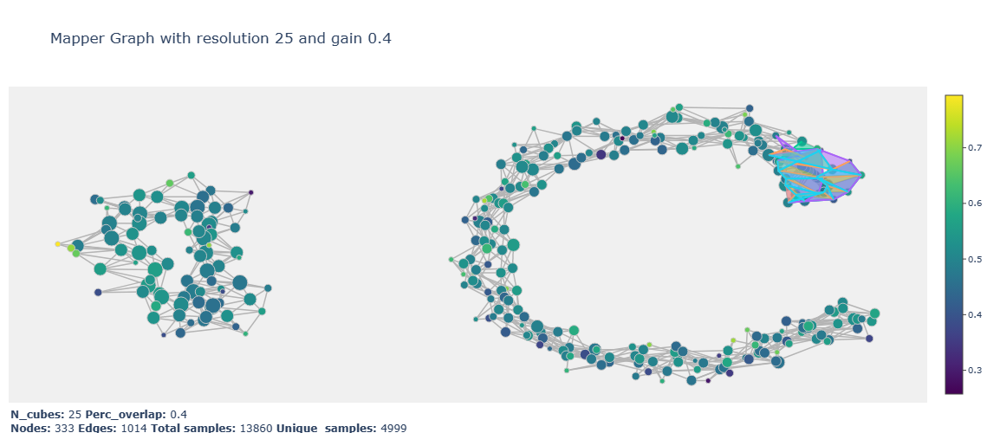

This Mapper graph has 1221 two-simplices
Were gonna need more traces


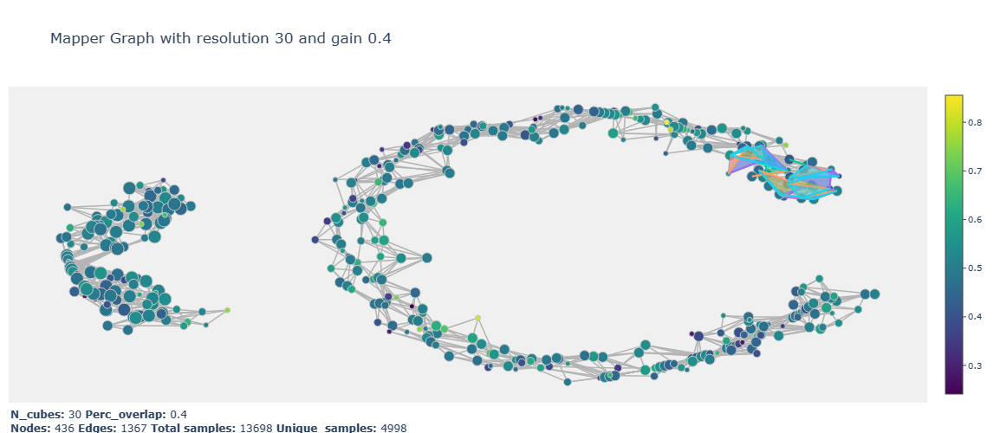

This Mapper graph has 64 two-simplices
Were gonna need more traces


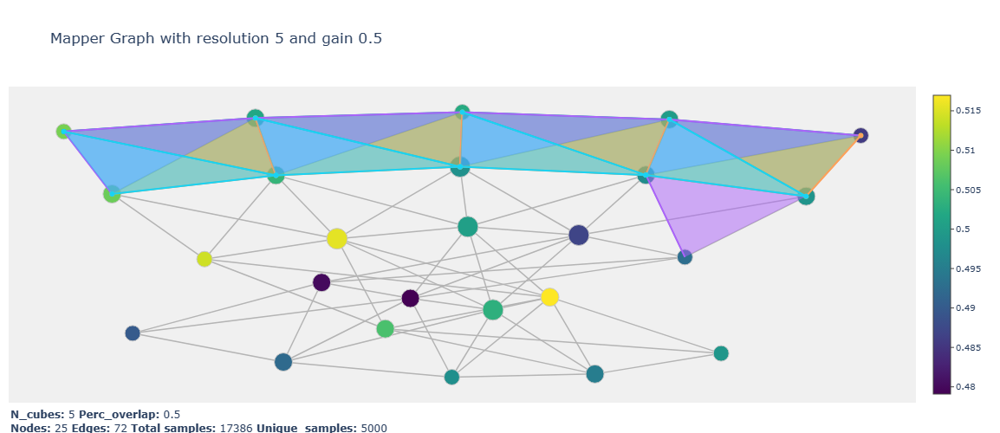

This Mapper graph has 248 two-simplices
Were gonna need more traces


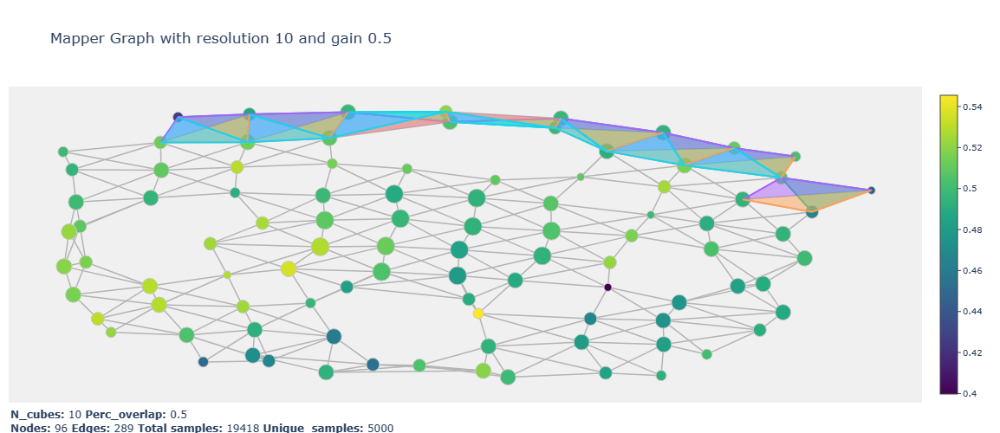

This Mapper graph has 470 two-simplices
Were gonna need more traces


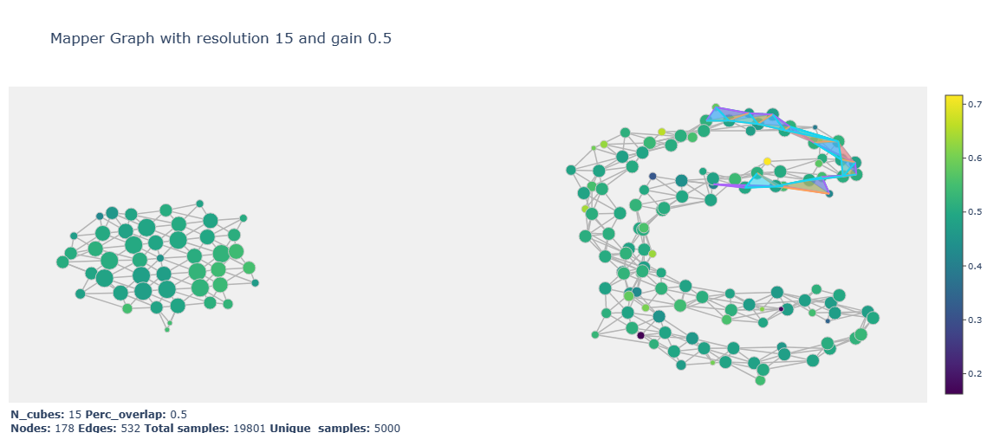

This Mapper graph has 740 two-simplices
Were gonna need more traces


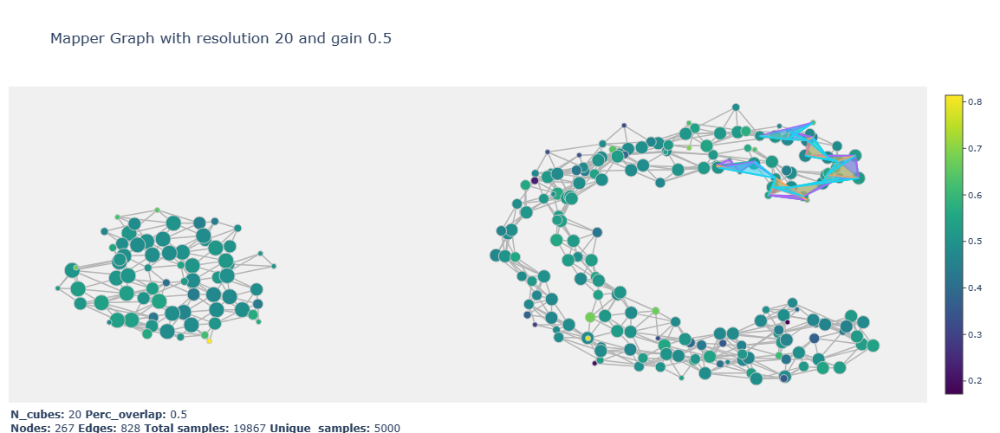

This Mapper graph has 1083 two-simplices
Were gonna need more traces


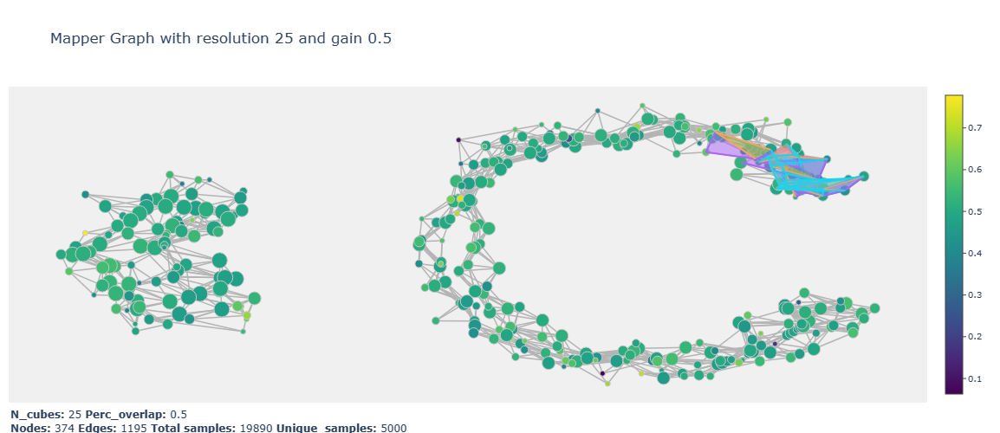

This Mapper graph has 1401 two-simplices
Were gonna need more traces


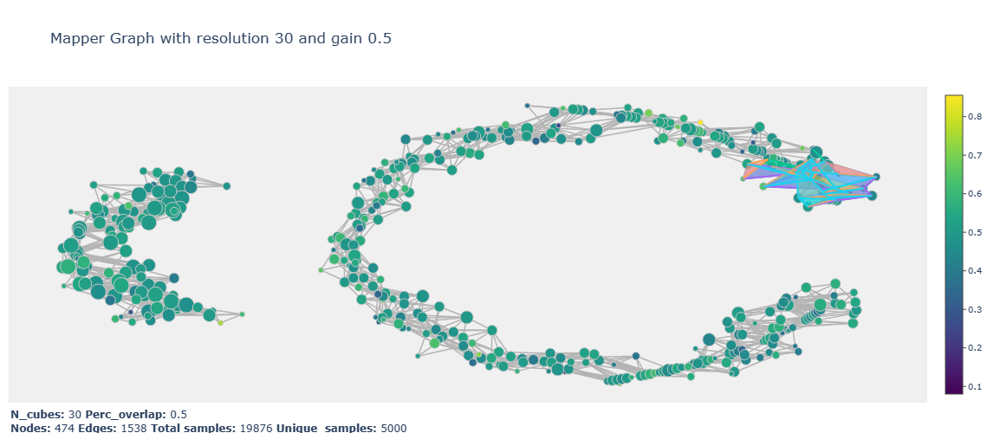

In [51]:
gains = [0.01,0.05,0.1,0.15,0.2,0.25,0.3,0.4,0.5]
resolutions = [5,10,15,20,25,30]

timings = np.zeros((len(gains)*len(resolutions),3))
i=0
for p in gains:
    for n in resolutions:
        simp_complex = mapper.map(lens, X=data, cover=km.Cover(n_cubes=n, perc_overlap=p), nerve = nerve.GraphNerve(min_intersection=1))
        kmgraph, _, __ = get_mapper_graph(simp_complex)
        start = time.clock()
        Tris = find_triangles(kmgraph)
        s = len(Tris['triangles'])
        print(f'This Mapper graph has {s} two-simplices')
        if s > 0:
            graph = plotlyviz(simp_complex, title=f'Mapper Graph with resolution {n} and gain {p}')
            fills = find_coords(Tris,kmgraph)
            for i in range(len(fills)):
                graph.add_trace(fills[i])
            graph.show()    
            end = time.clock()
            timings[i]=[p,n,end-start]
        else: 
            end = time.clock()
            timings[i]=[p,n,end-start]
        
            

The function `find_coords` doesn't fully work and gives us some issues with graphing later that we can see above in our large test of producing 2-mapper graphs with varying gain and resolution $(g,r)$. As such our next idea is to graph with the following intention. The set of traces $\{D_{\alpha}\}$ we will append to the 1-mapper graph will be a dictionary of simplices $(a_{\alpha},b_{\alpha},c_{\alpha})\in D_{\alpha}$, where for all $(a,b,c),(d,e,f)\in D_{\alpha}$ we have that $a=d$ and $b=e$. Choosing our dictionaries this way is strictly due to the fact that the `fill='toself'` argument in a Scatter trace in `Plotly` is dependent on edge orientation when filling a plot. 

In [79]:
# Redine 'find_coords' function to properly produce traces for graphing

def find_coords2(Tri,kmgraph):
    # First we should sort Tri into bins 
    # where each bin contains simplices with equal v0, v1.
    
    simplex_groups = {}
    
    for i,simplex in enumerate(Tri['triangles']):
        # Generate the first trace of the trace dictionary
        if i == 0:
            simplex_groups[f'trace{i}'] = [Tri['triangles'][i]]
        # See if the current simplex has 1 edge matching the simplex before it. 
        # If it matches append to most recent trace. If not add new trace to dict
        if i > 0:
            if simplex_groups[list(simplex_groups)[-1]][0]['v0'] == Tri['triangles'][i]['v0'] and \
            simplex_groups[list(simplex_groups)[-1]][0]['v1'] == Tri['triangles'][i]['v1']:
                simplex_groups[list(simplex_groups)[-1]].append(Tri['triangles'][i])
                
            else:
                k = len(list(simplex_groups))
                simplex_groups[f'trace{k}'] = [Tri['triangles'][i]]
    #print(simplex_groups)   
    # Now with our dictionarys sorted correctly (hopefully) 
    # we can find our coordinates for graphing
    nodetrace = plotly_graph(kmgraph)[1]
    simplex_traces = {}
    k = len(list(simplex_groups))
    for i in range(k):
        xcoord_list = []
        ycoord_list = []
        for j in range(len([list(simplex_groups)[i]])):
            xcoords = [nodetrace['x'][simplex_groups[list(simplex_groups)[i]][j]['v0']], 
                       nodetrace['x'][simplex_groups[list(simplex_groups)[i]][j]['v1']],
                       nodetrace['x'][simplex_groups[list(simplex_groups)[i]][j]['v2']],
                       nodetrace['x'][simplex_groups[list(simplex_groups)[i]][j]['v0']],
                       None]
            ycoords = [nodetrace['y'][simplex_groups[list(simplex_groups)[i]][j]['v0']],
                       nodetrace['y'][simplex_groups[list(simplex_groups)[i]][j]['v1']],
                       nodetrace['y'][simplex_groups[list(simplex_groups)[i]][j]['v2']],
                       nodetrace['y'][simplex_groups[list(simplex_groups)[i]][j]['v0']],
                       None]
            
            xcoord_list.extend(xcoords)
            ycoord_list.extend(ycoords)
        # Once we have are coordinates for each trace we construct our graph trace
        # We will include 'color' arguments so that the coloring makes sense once
        # we can get this thing to run properly
        simplex_traces[list(simplex_groups)[i]] = dict(
            type = 'scatter',
            x = xcoord_list,
            y = ycoord_list,
            fill = 'toself')
    #print(simplex_traces)       
    return simplex_traces

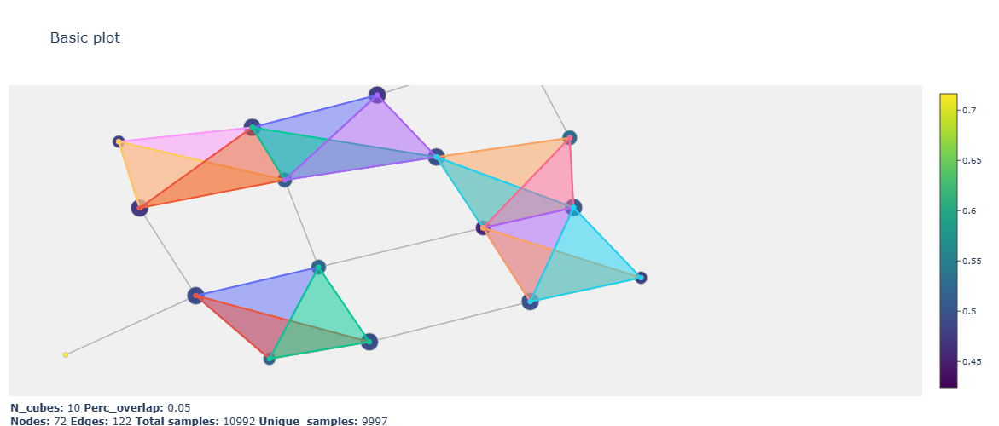

In [80]:
works = find_coords2(Tri,kmgraph)
# Now with traces of our 2-simplices we can add them to the Mapper figure.
for i in range(len(list(works))):
    graph.add_trace(works[f'trace{i}'])
graph.show()

IT WORKS!! YES

Now we can run our gain/resolution test again.

This Mapper graph has 0 two-simplices
This Mapper graph has 0 two-simplices
This Mapper graph has 0 two-simplices
This Mapper graph has 8 two-simplices


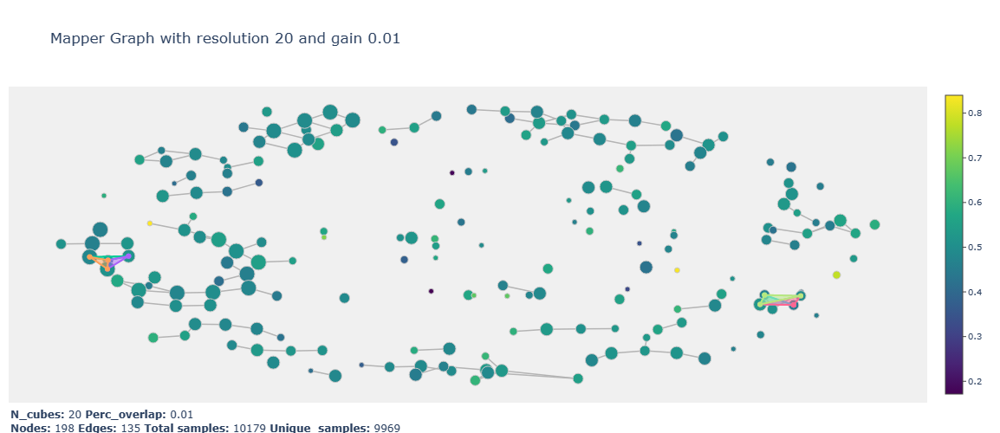

This Mapper graph has 0 two-simplices
This Mapper graph has 4 two-simplices


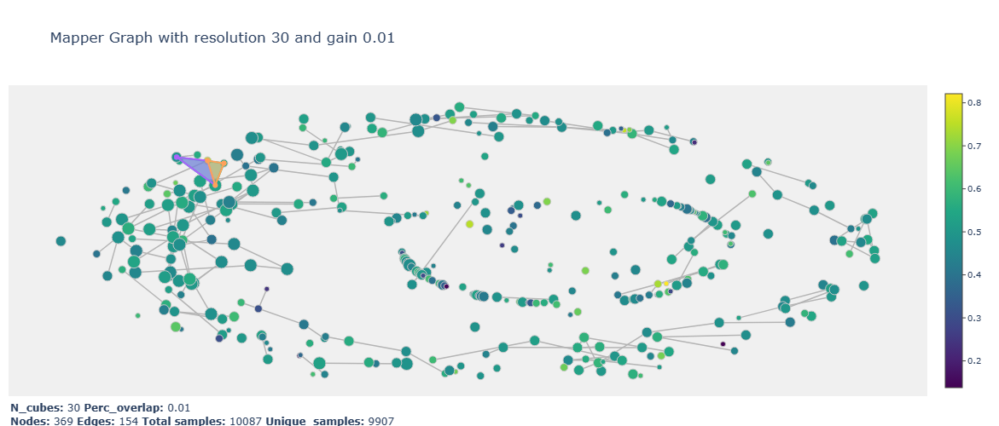

This Mapper graph has 32 two-simplices


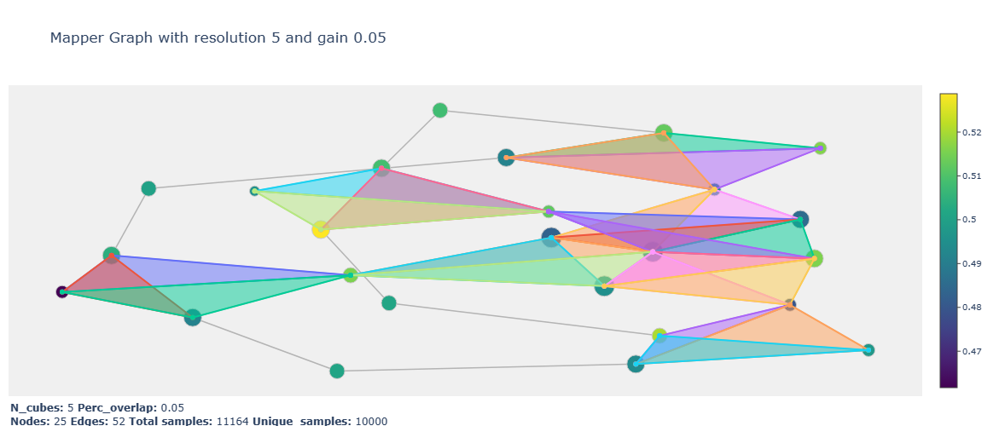

This Mapper graph has 53 two-simplices


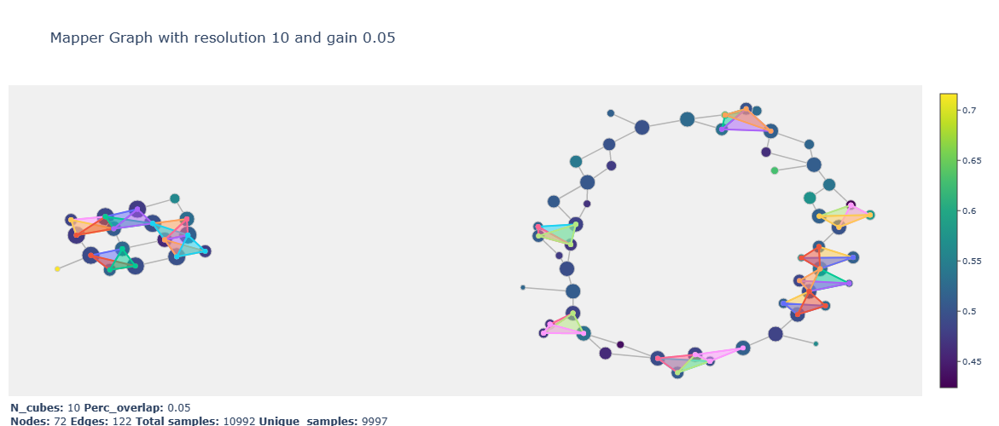

This Mapper graph has 64 two-simplices


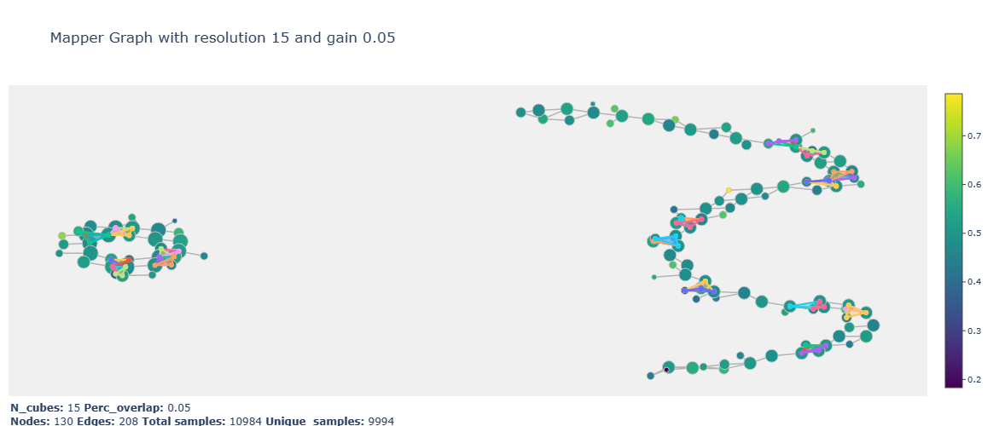

This Mapper graph has 117 two-simplices


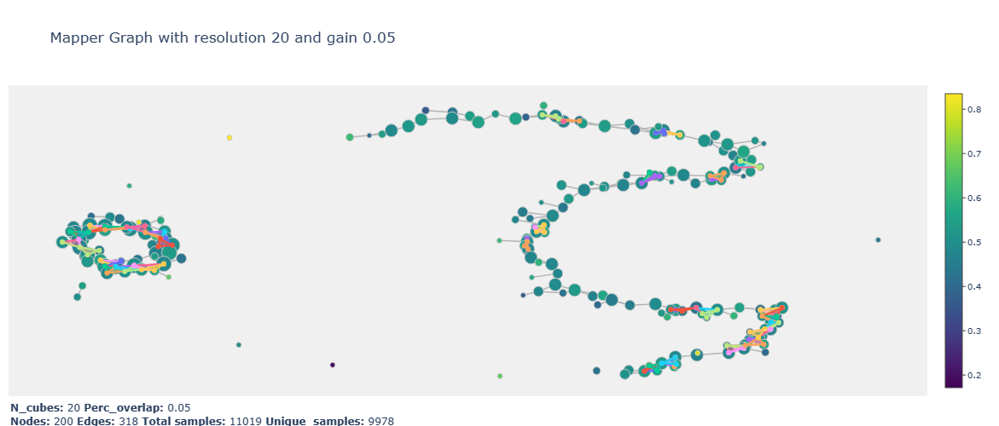

This Mapper graph has 85 two-simplices


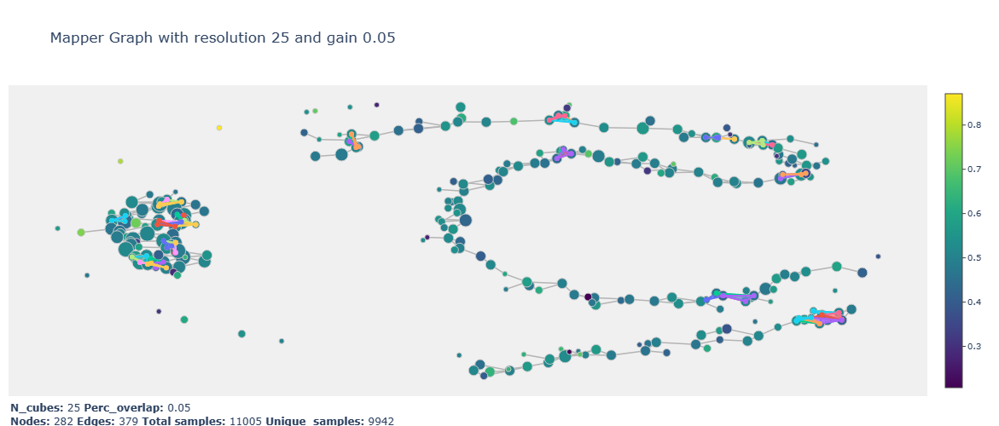

This Mapper graph has 77 two-simplices


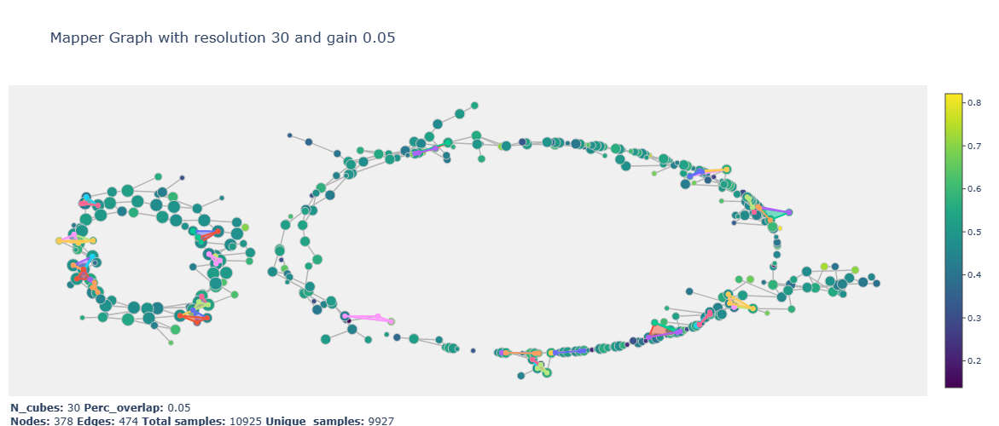

This Mapper graph has 32 two-simplices


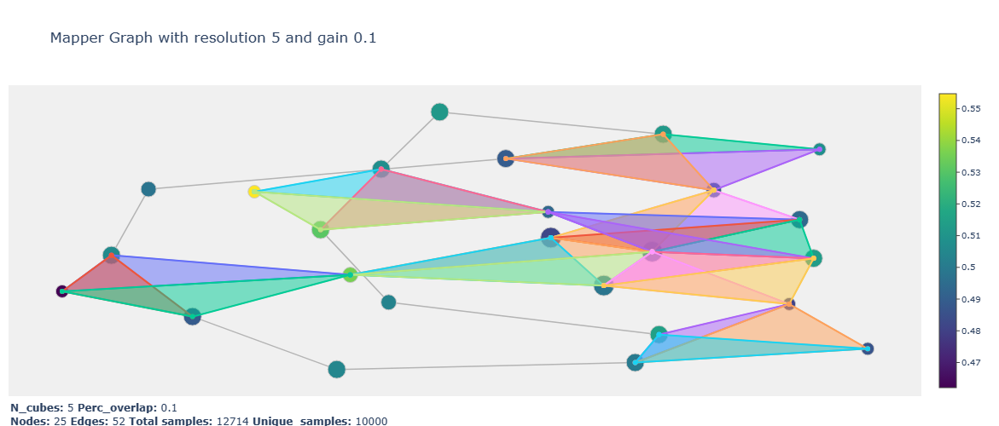

This Mapper graph has 114 two-simplices


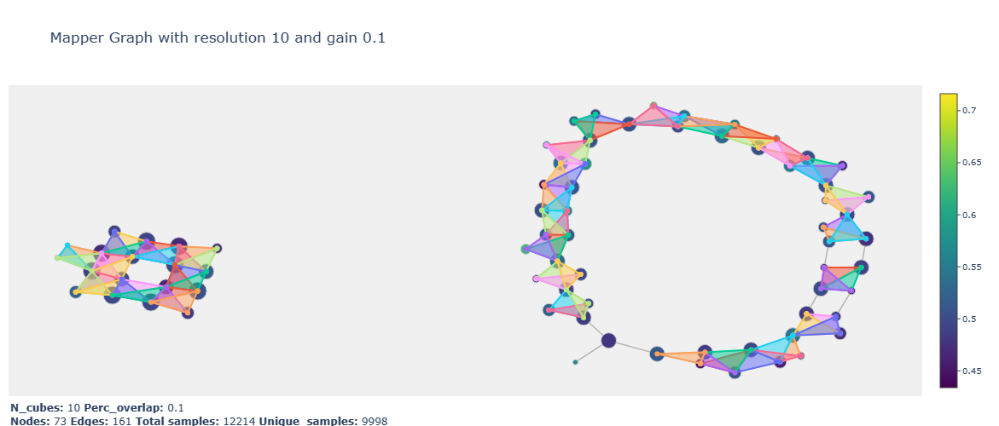

This Mapper graph has 190 two-simplices


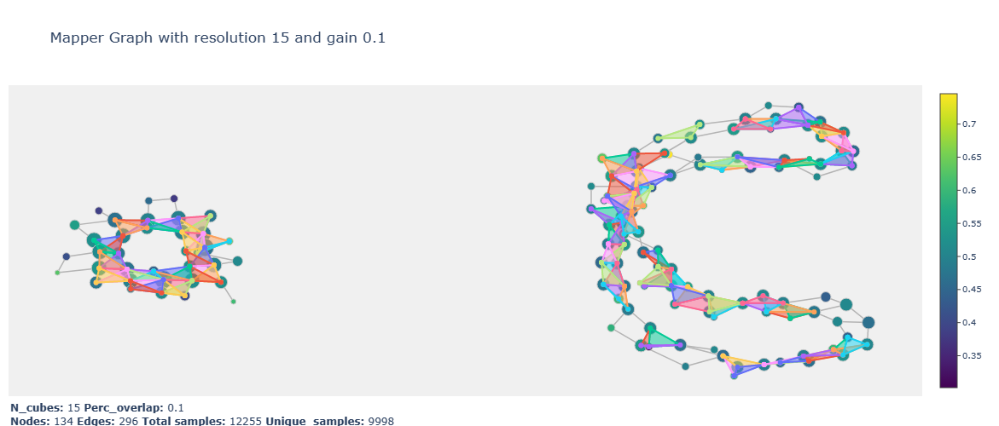

This Mapper graph has 253 two-simplices


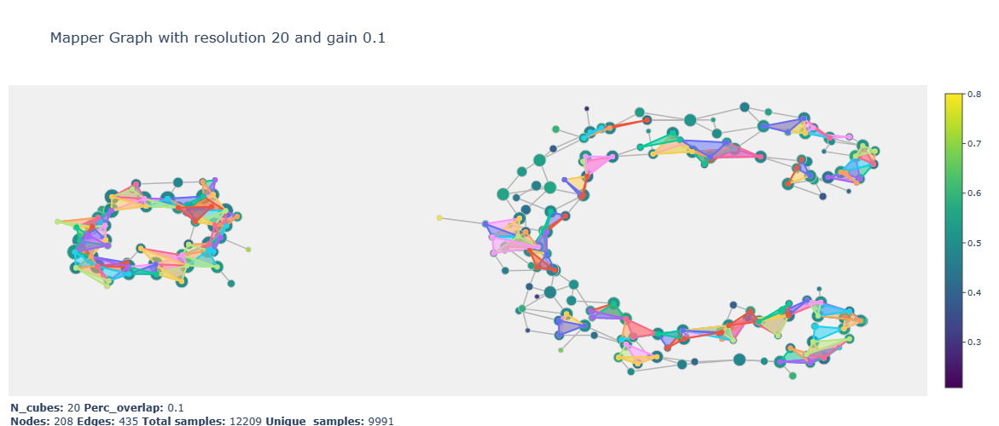

This Mapper graph has 259 two-simplices


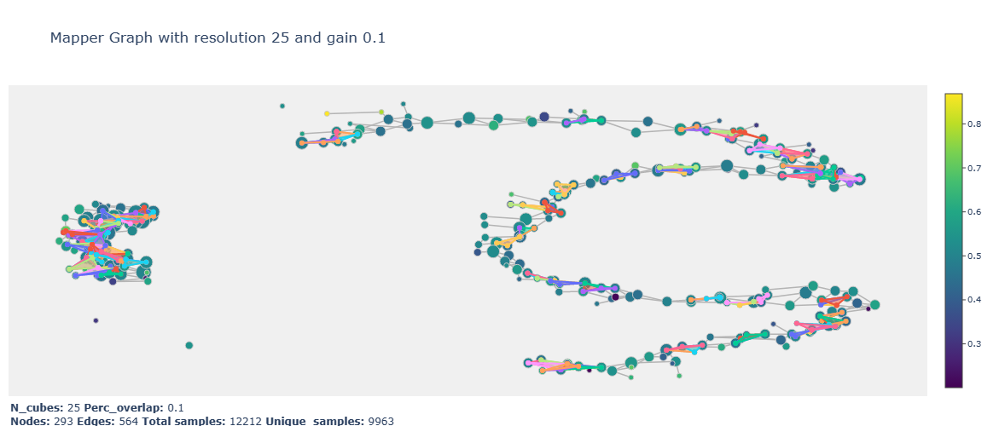

This Mapper graph has 303 two-simplices


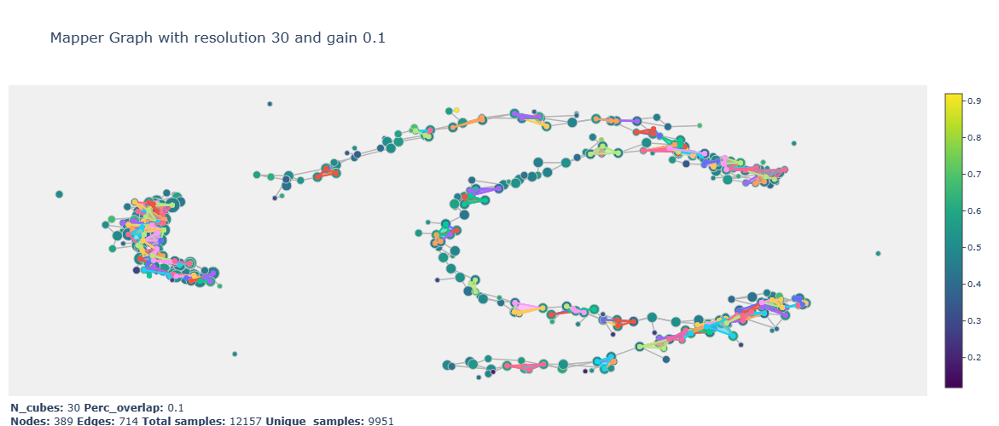

This Mapper graph has 32 two-simplices


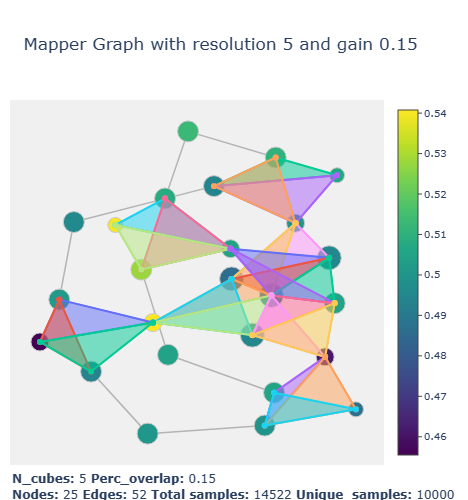

This Mapper graph has 130 two-simplices


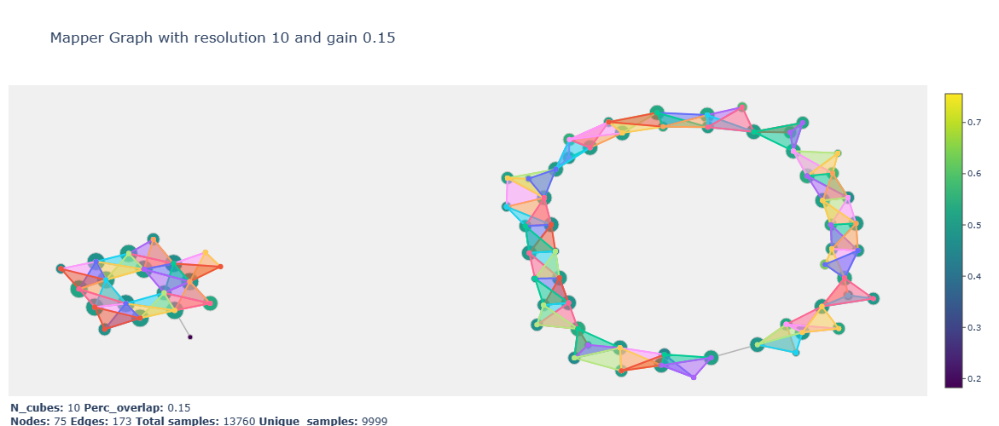

This Mapper graph has 276 two-simplices


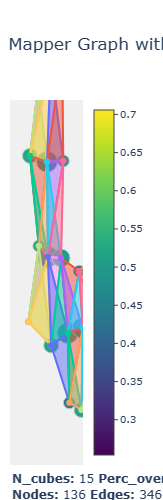

This Mapper graph has 376 two-simplices


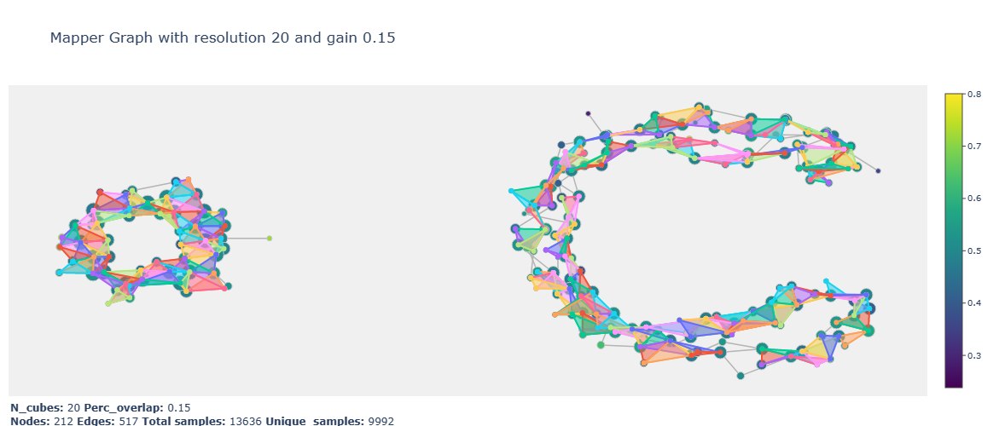

This Mapper graph has 510 two-simplices


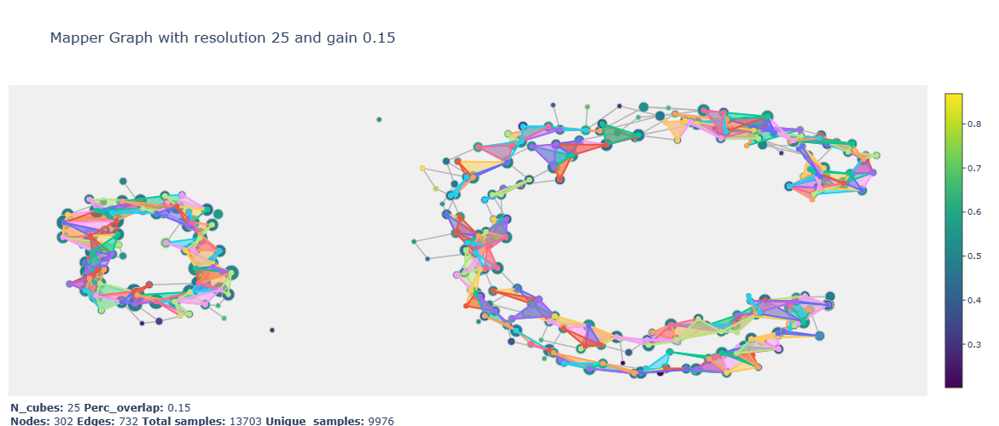

This Mapper graph has 598 two-simplices


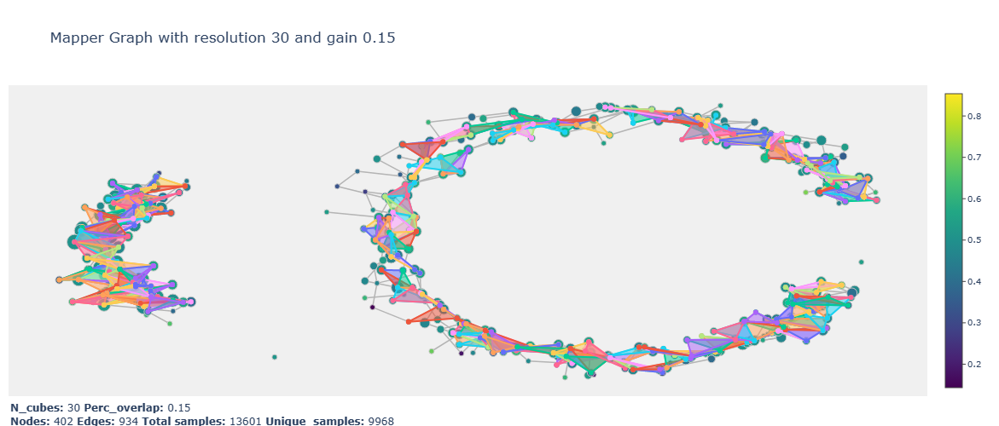

This Mapper graph has 32 two-simplices


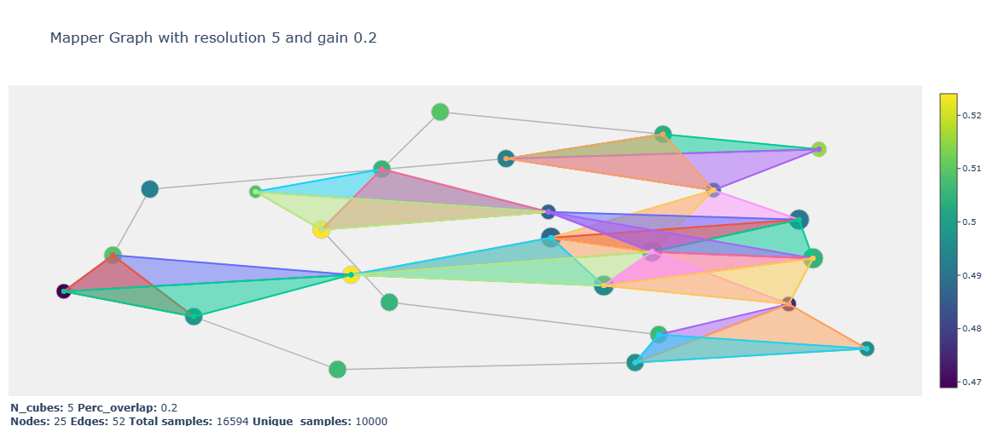

This Mapper graph has 130 two-simplices


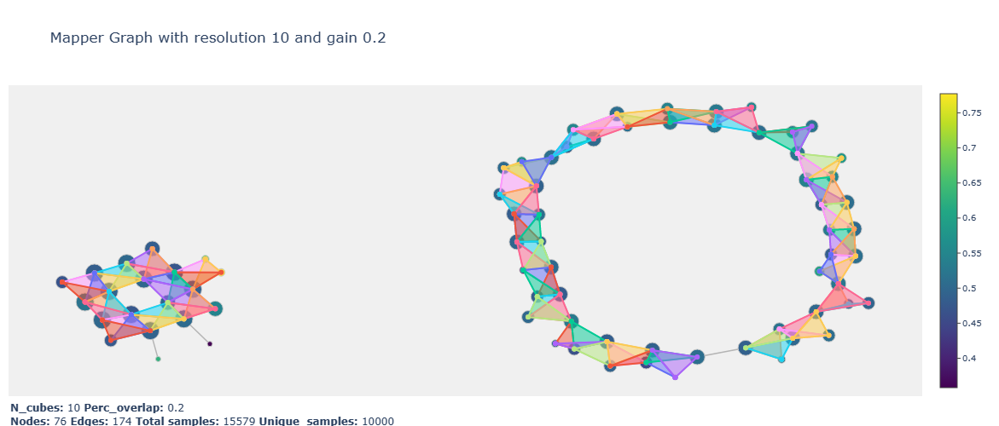

This Mapper graph has 294 two-simplices


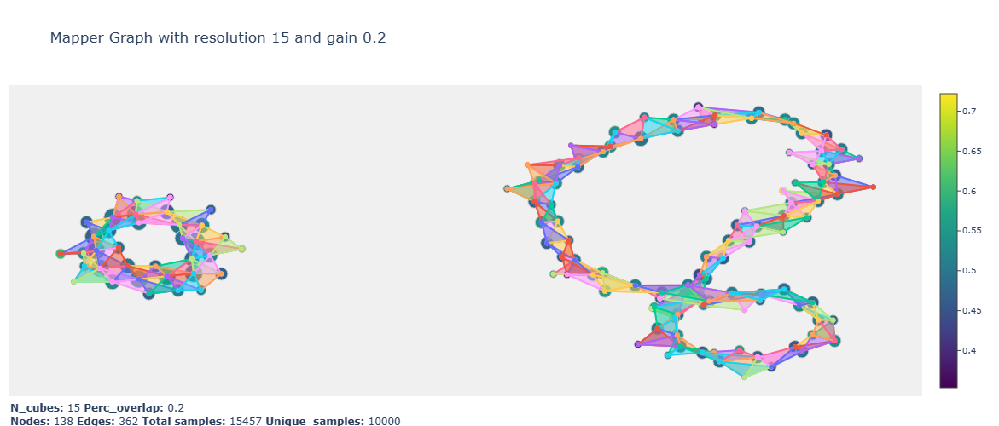

This Mapper graph has 473 two-simplices


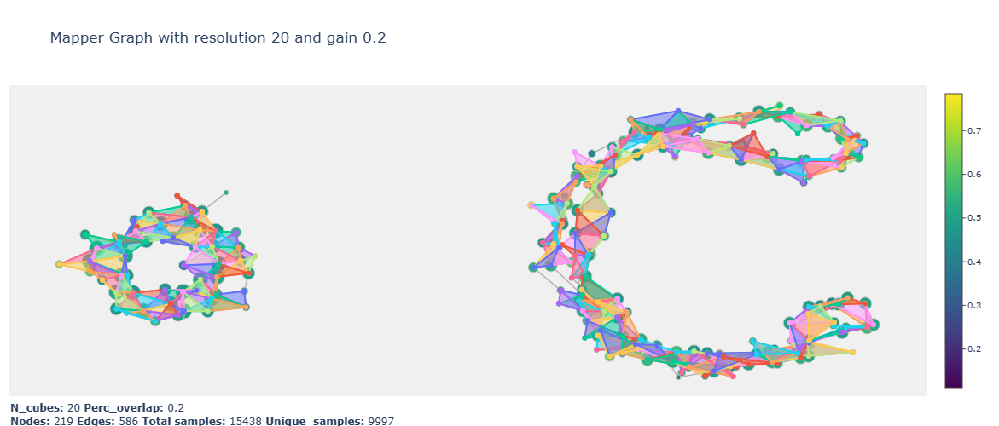

This Mapper graph has 683 two-simplices


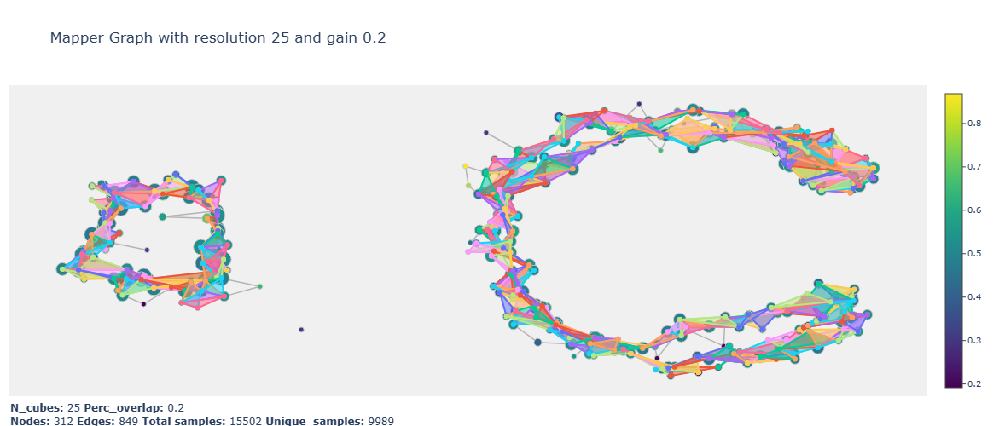

This Mapper graph has 851 two-simplices


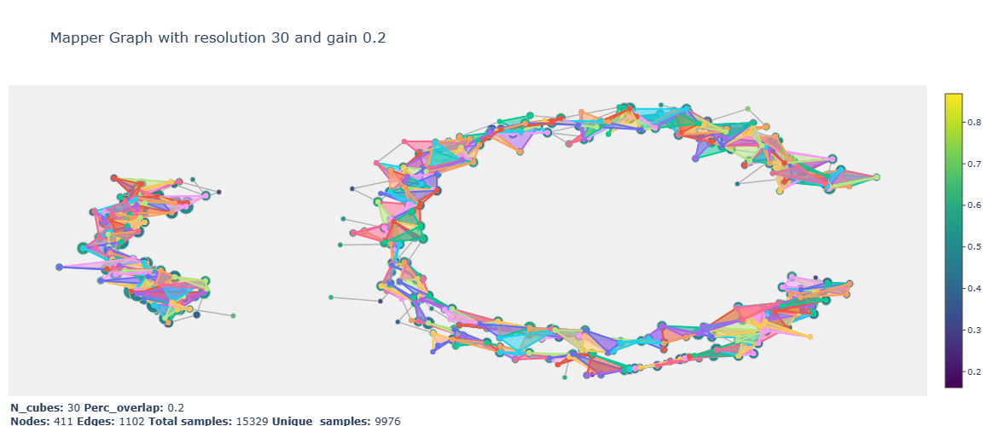

This Mapper graph has 32 two-simplices


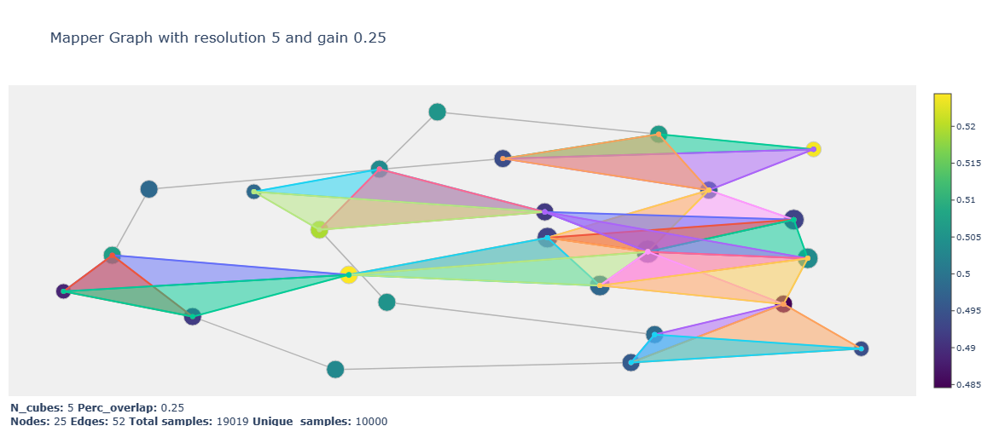

This Mapper graph has 150 two-simplices


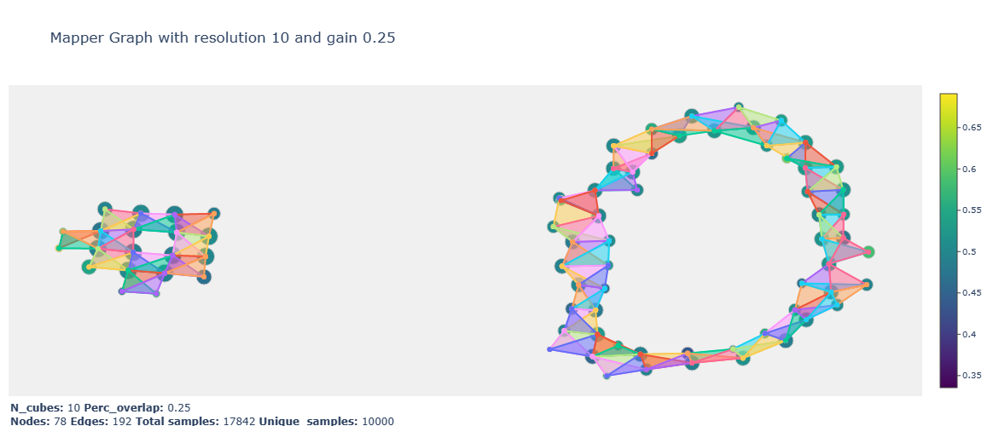

This Mapper graph has 321 two-simplices


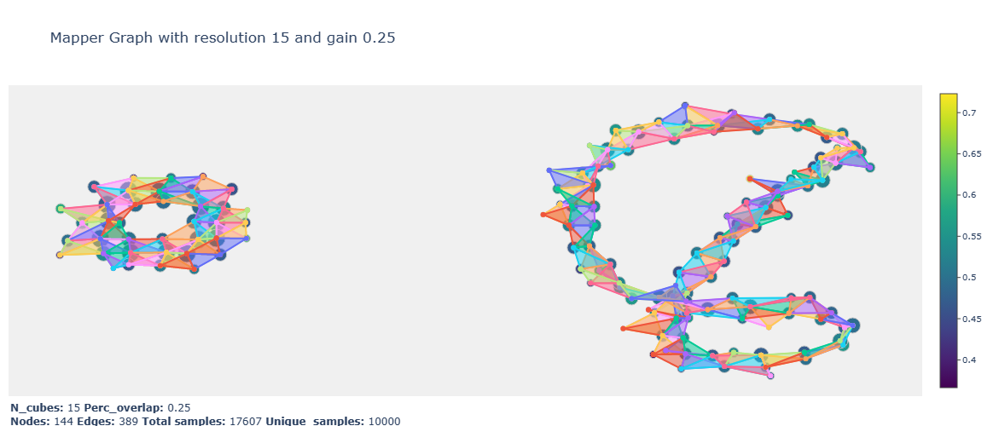

This Mapper graph has 544 two-simplices


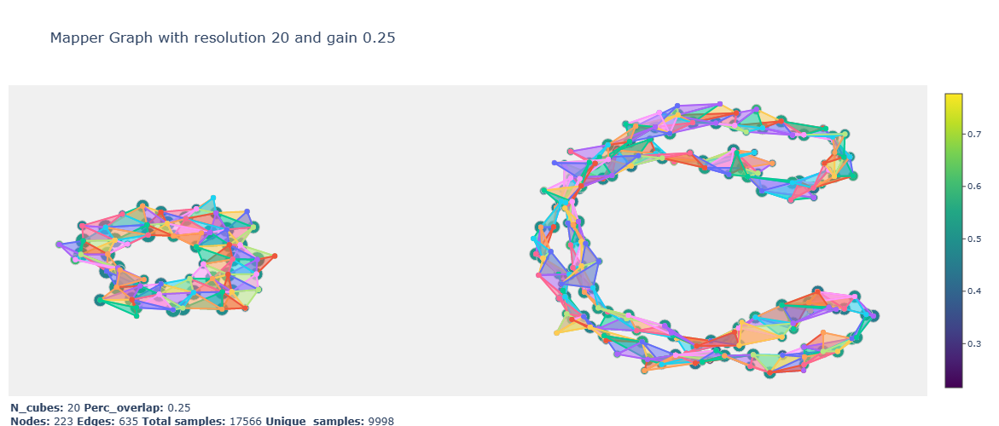

This Mapper graph has 811 two-simplices


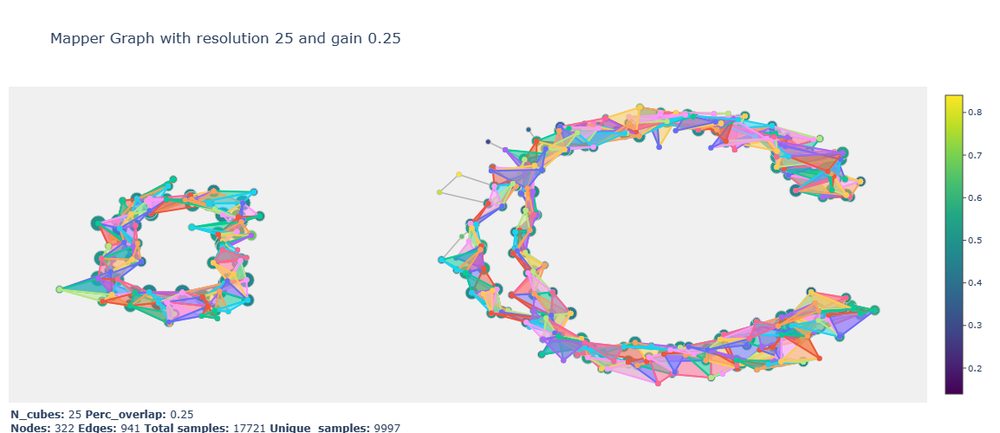

This Mapper graph has 1058 two-simplices


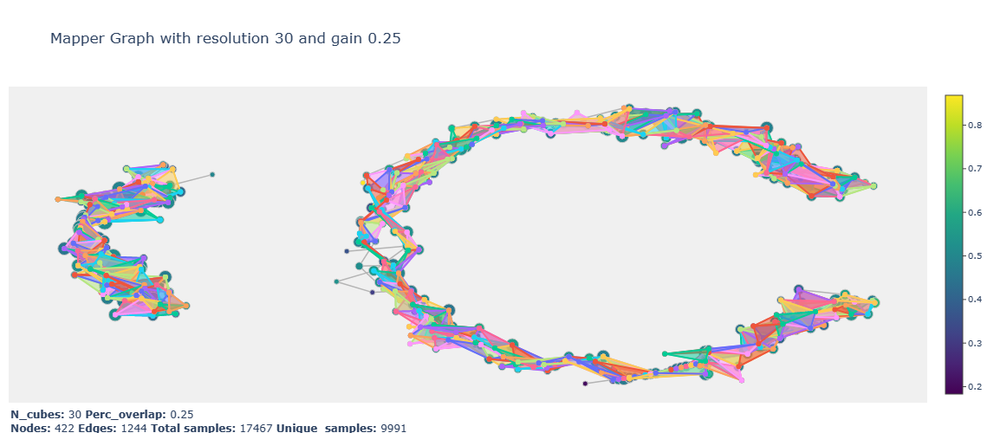

This Mapper graph has 32 two-simplices


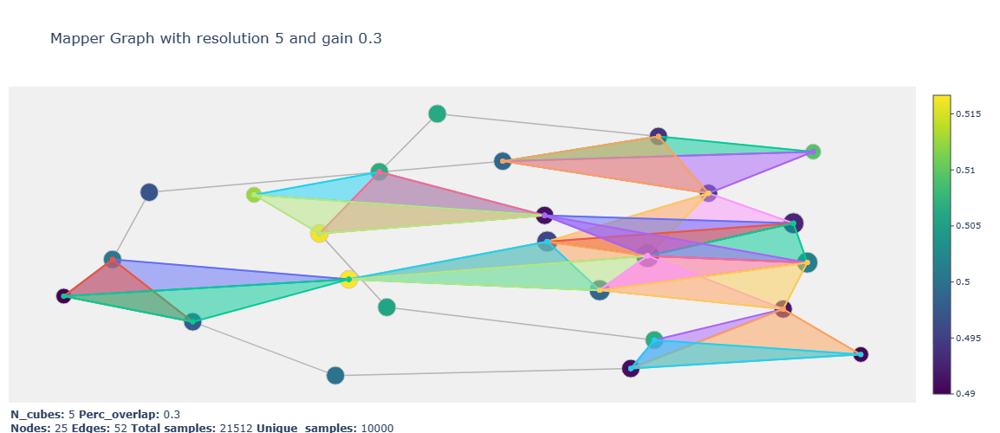

This Mapper graph has 160 two-simplices


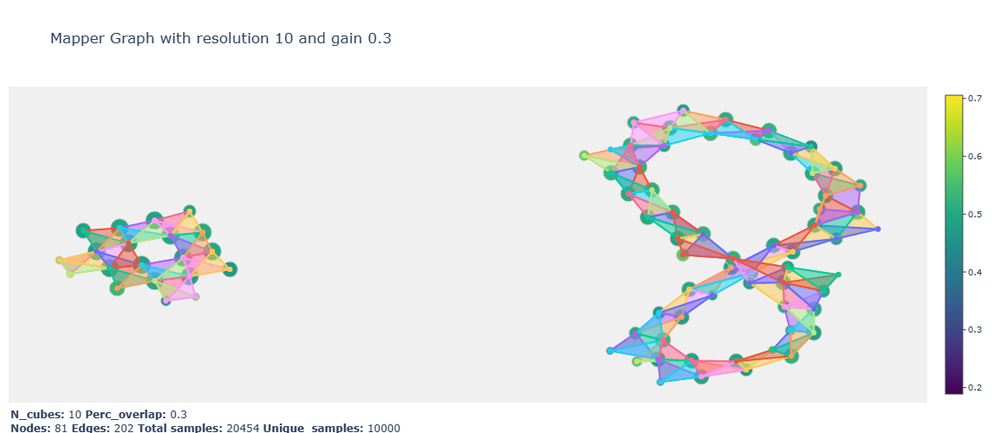

This Mapper graph has 349 two-simplices


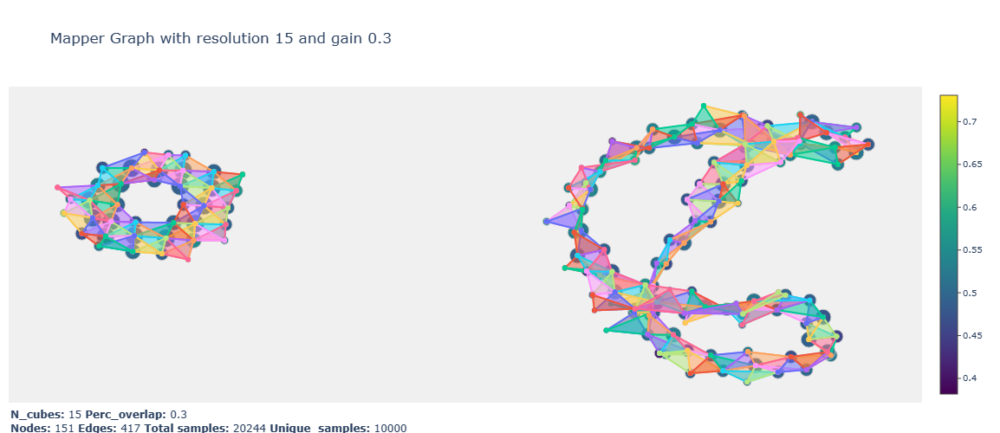

This Mapper graph has 590 two-simplices


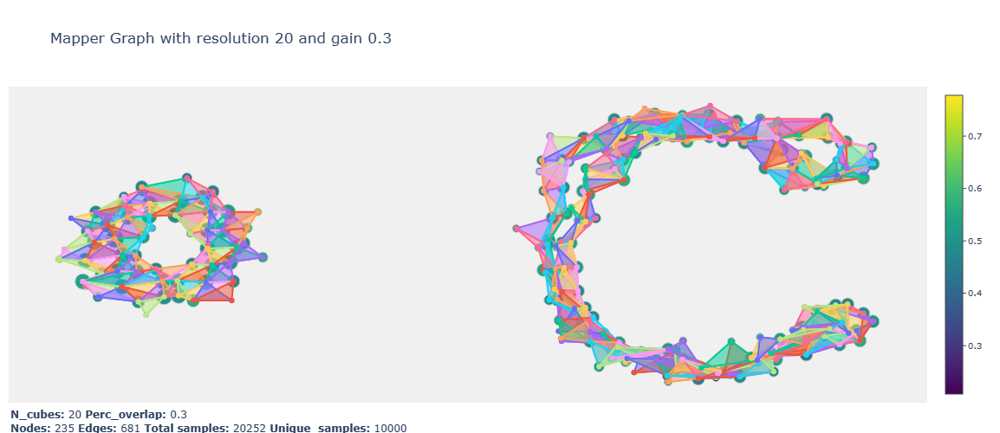

This Mapper graph has 891 two-simplices


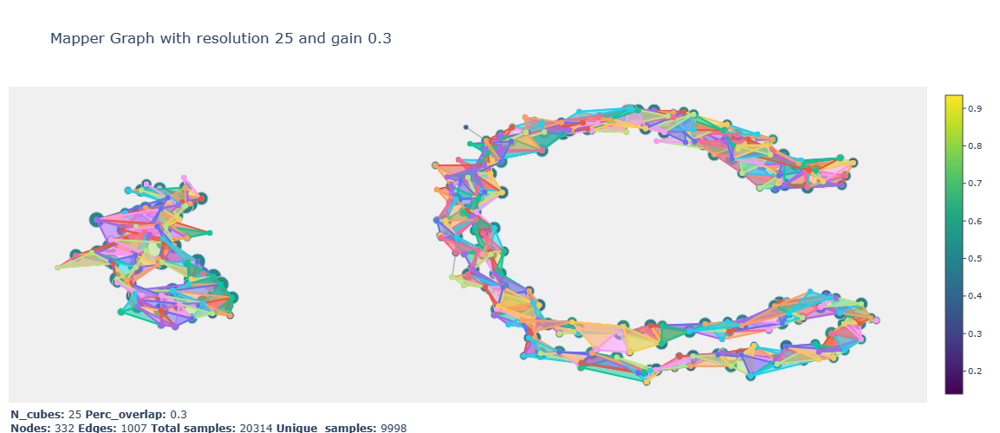

This Mapper graph has 1176 two-simplices


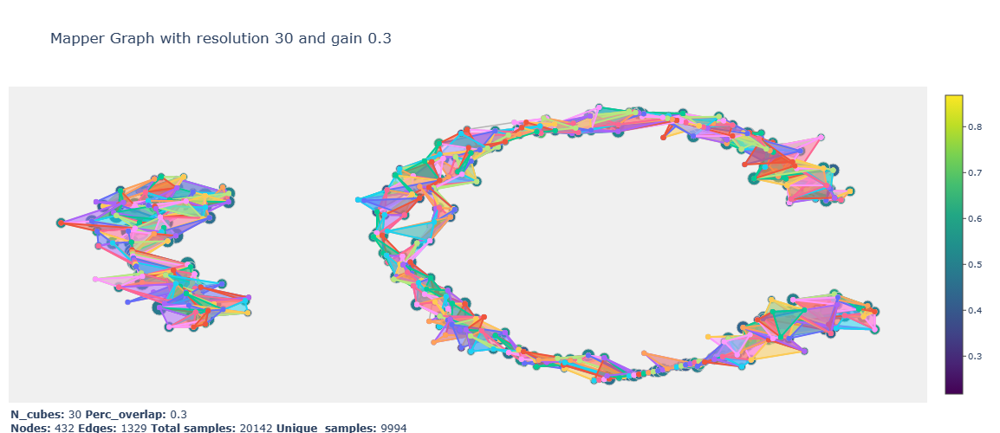

This Mapper graph has 56 two-simplices


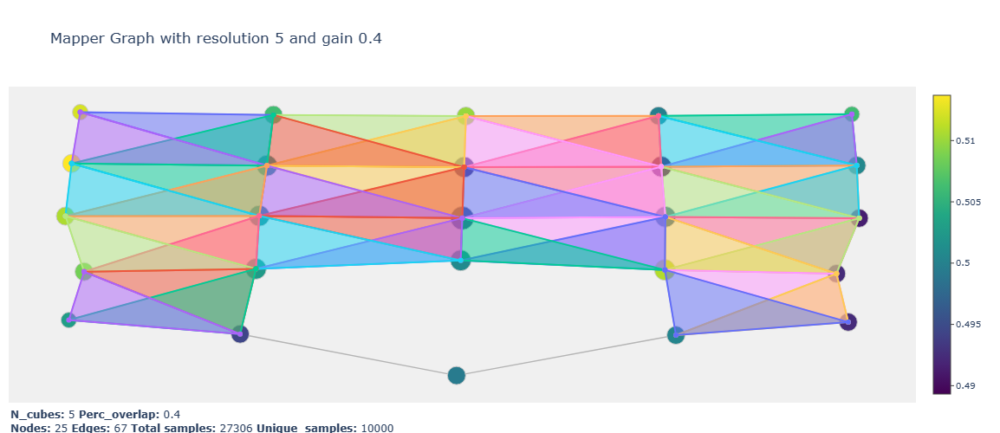

This Mapper graph has 220 two-simplices


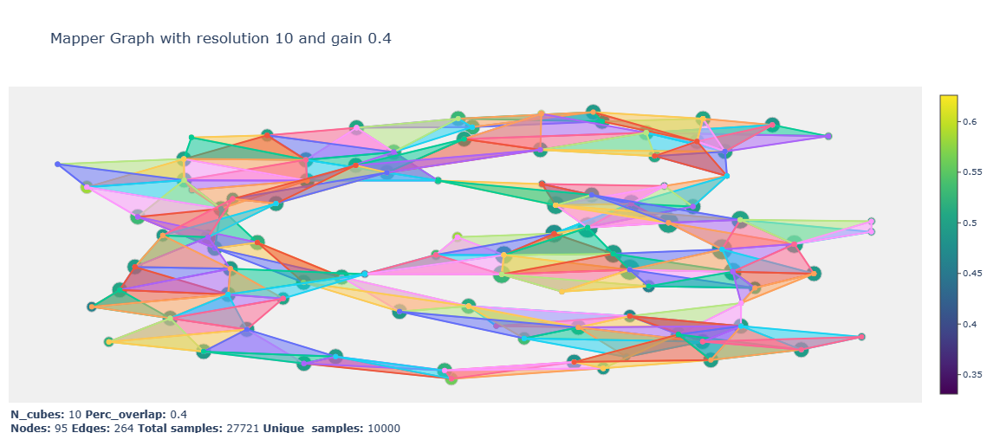

This Mapper graph has 420 two-simplices


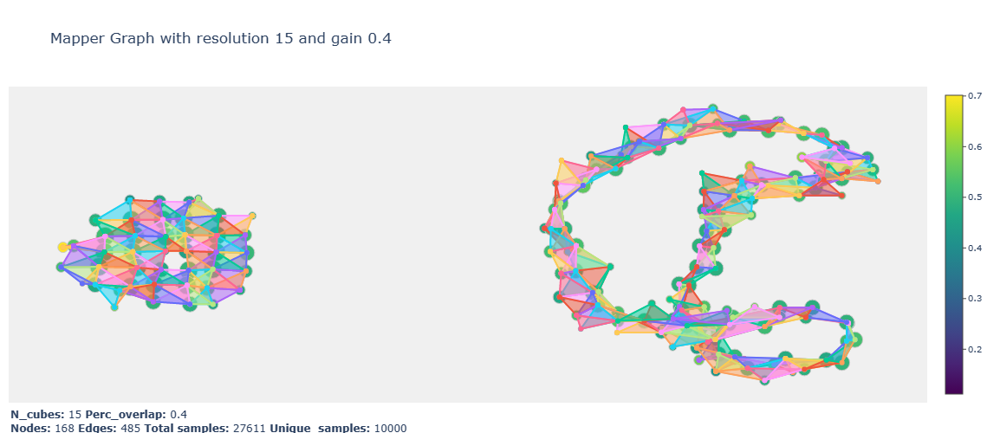

This Mapper graph has 675 two-simplices


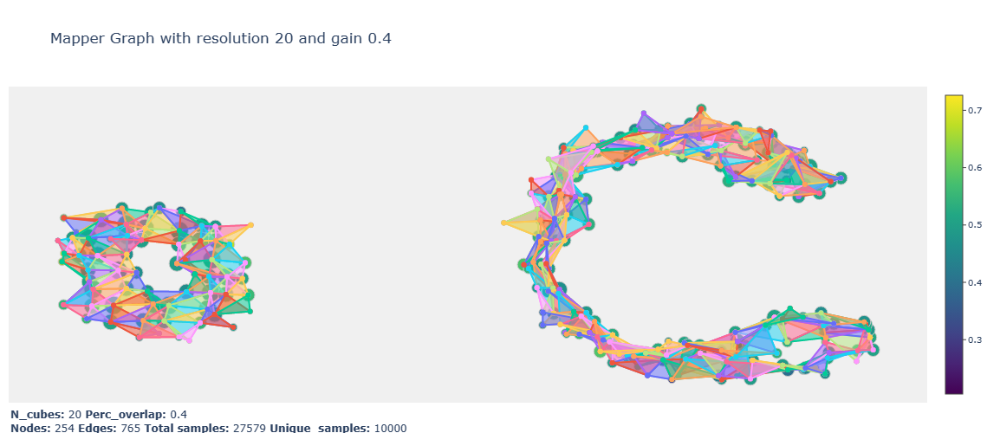

This Mapper graph has 975 two-simplices


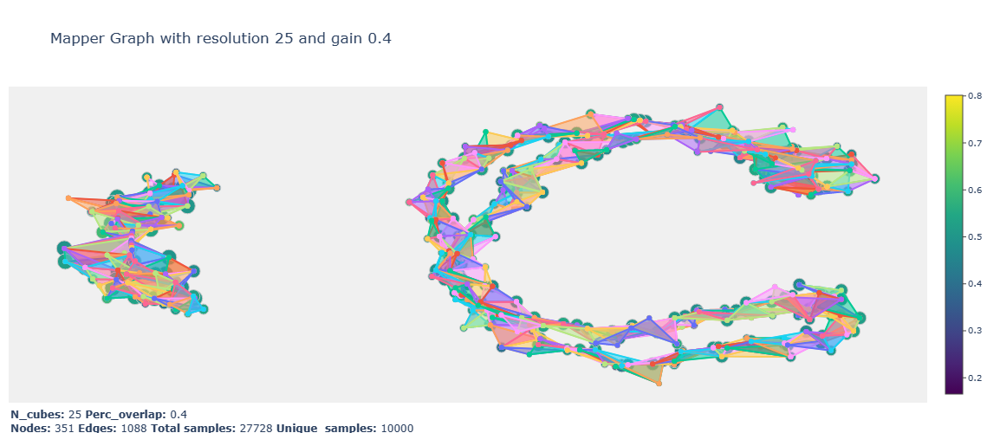

This Mapper graph has 1354 two-simplices


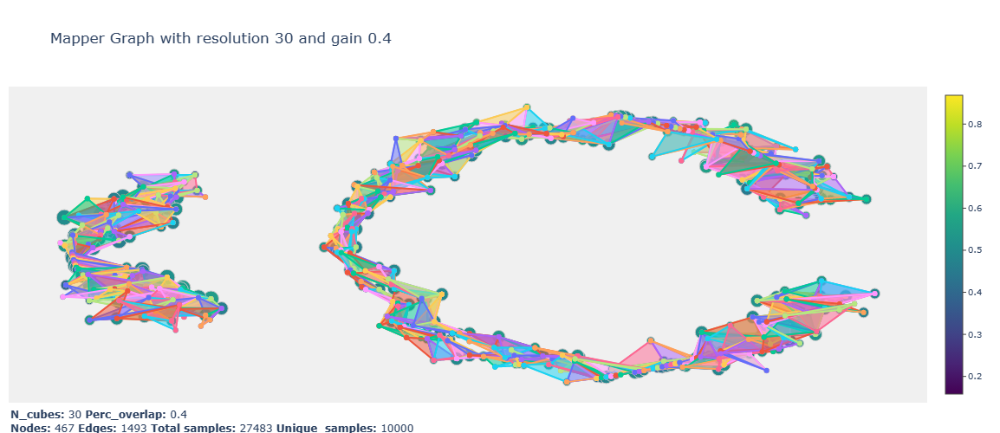

This Mapper graph has 64 two-simplices


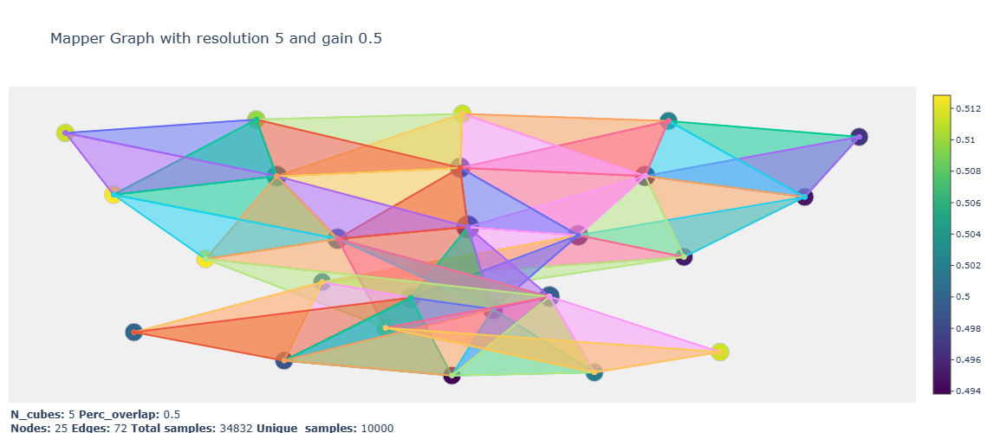

This Mapper graph has 245 two-simplices


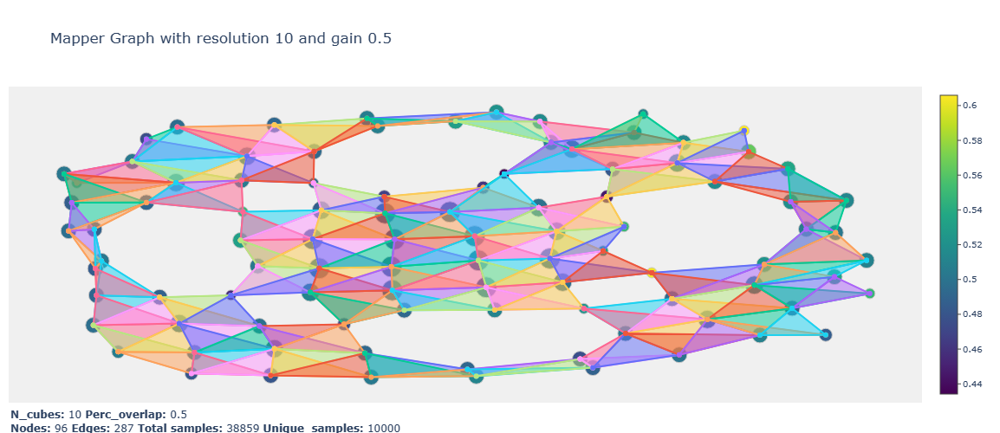

This Mapper graph has 490 two-simplices


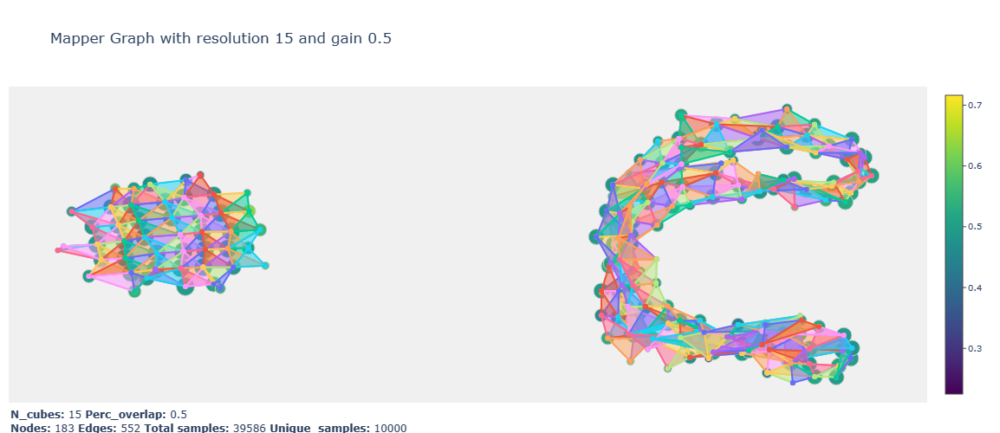

This Mapper graph has 772 two-simplices


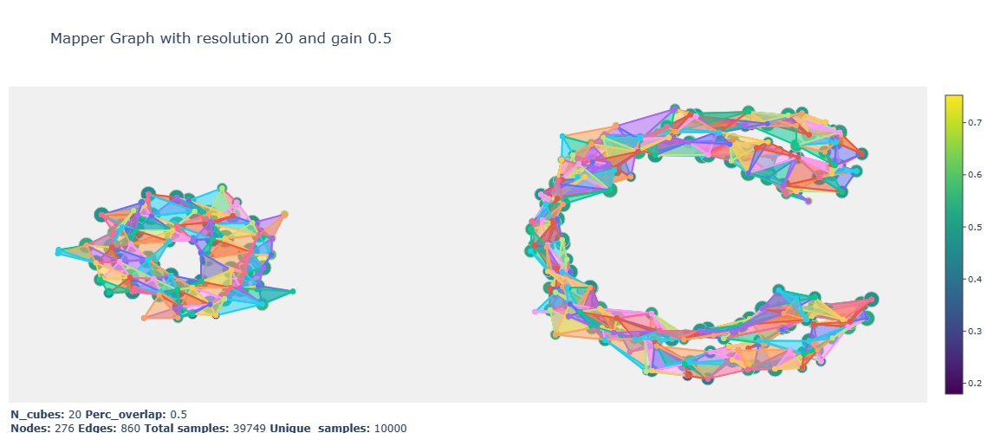

This Mapper graph has 1129 two-simplices


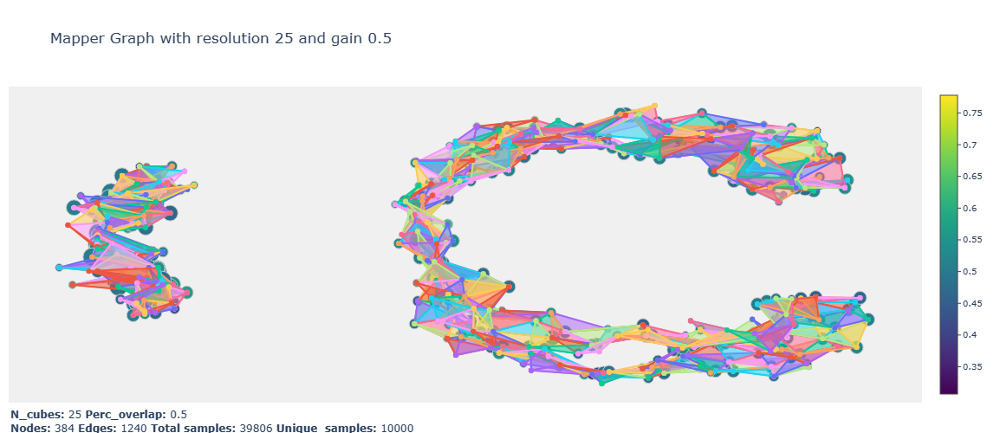

This Mapper graph has 1554 two-simplices


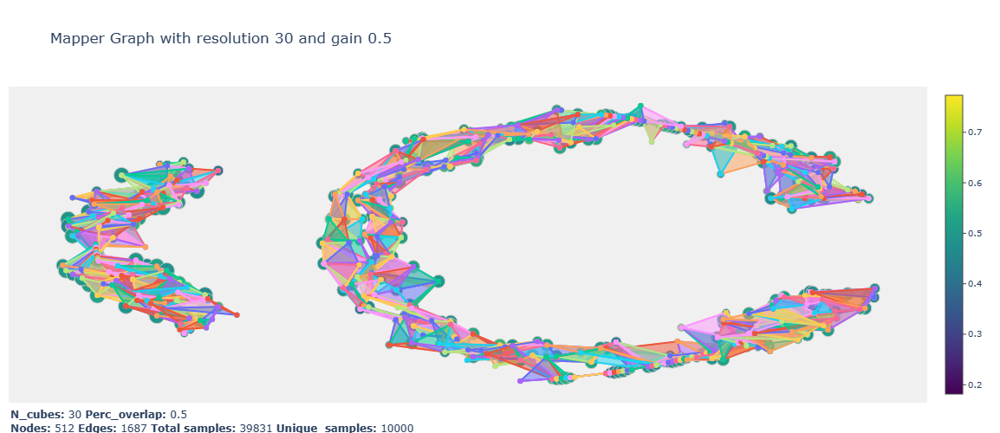

In [85]:
gains = [0.01,0.05,0.1,0.15,0.2,0.25,0.3,0.4,0.5]
resolutions = [5,10,15,20,25,30]

timings = np.zeros((len(gains)*len(resolutions),4))
k=0
for p in gains:
    for n in resolutions:
        simp_complex = mapper.map(lens, X=data, cover=km.Cover(n_cubes=n, perc_overlap=p), nerve = nerve.GraphNerve(min_intersection=1))
        kmgraph, _, __ = get_mapper_graph(simp_complex)
        start = time.process_time()
        Tris = find_triangles(kmgraph)
        s = len(Tris['triangles'])
        print(f'This Mapper graph has {s} two-simplices')
        if s > 0:
            graph = plotlyviz(simp_complex, title=f'Mapper Graph with resolution {n} and gain {p}')
            fills = find_coords2(Tris,kmgraph)
            for i in range(len(list(fills))):
                graph.add_trace(fills[f'trace{i}'])
            graph.show()    
            end = time.process_time()
            timings[k]=[p,n,s,end-start]
            k += 1
        else: 
            end = time.process_time()
            timings[k]=[p,n,s,end-start]
            k += 1

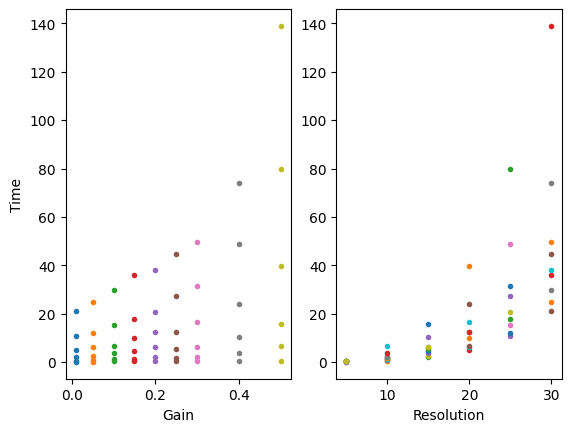

In [125]:
fig, (ax1,ax2) = plt.subplots(1,2,sharex=False, sharey=False)
for r in range(10):
    ax1.plot(timings[r*6:(r+1)*6,0],timings[r*6:(r+1)*6,3], '.')
for k in range(9):
    for r in range(6):
        ax2.plot(timings[6*k+r,1],timings[6*k+r,3],'.')
ax2.set_xlabel('Resolution')
ax1.set_ylabel('Time')
ax1.set_xlabel('Gain')
#fig.title('2-Simplex Computation Time')
fig.show()

For the above plots (we should make this look better). At the highest resolution and gain it only takes a little over two minutes to graph. This is with a data set with 10,000 points. We should run more tests to see how long 2-mapper computations take to produce these graph. It feels pretty quick though, I guess we should vary this by testing with larger data sets.

## Generate samples from 2-dimensional spaces
Now we want to test the 2-Mapper algorithm on datasets which have nontrivial 2-dimensional structure. To do so we will sample from some conventional surfaces: the sphere, the torus, and maybe the genus 2 torus.

In [54]:
a,b = [1,2,3],[4,5,6]
c = zip(a,b)
for x in c:
    print(x)

(1, 4)
(2, 5)
(3, 6)


In [26]:
## Sample from sphere
def sample_spherical(num_points, dim=3, radius=1):
    vec_list = [] 
    for _ in range(num_points):
        # Generate a random vector
        vec = np.random.normal(0, 1, dim)
        # Normalize and scale to desired radius
        vec /= np.linalg.norm(vec, axis=0)
        vec *= radius
        vec_list.append(list(vec))
    return vec_list

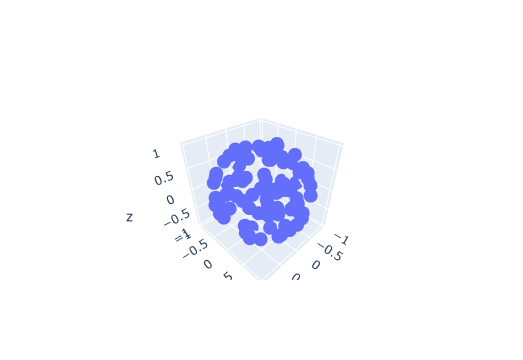

In [94]:
from mpl_toolkits.mplot3d import axes3d

phi = np.linspace(0, np.pi, 20)
theta = np.linspace(0, 2 * np.pi, 40)
x = np.outer(np.sin(theta), np.cos(phi))
y = np.outer(np.sin(theta), np.sin(phi))
z = np.outer(np.cos(theta), np.ones_like(phi))

vecs = sample_spherical(100)

xi = [vecs[i][0] for i in range(100)]
yi = [vecs[i][1] for i in range(100)]
zi = [vecs[i][2] for i in range(100)]

fig1 = go.Figure(data=[go.Scatter3d(x=xi,y=yi,z=zi, mode='markers')])
fig1.show()

In [32]:
def sample_torus(num_points, R=3, r=1):
    assert R>r, "This torus will self intersect. Choose R>r."
    point_list = []
    for _ in range(num_points):
        #Try uniform?
        theta = 2*np.pi*np.random.normal(0,1)
        phi = 2*np.pi*np.random.normal(0,1)
        x = (R+r*np.cos(phi))*np.cos(theta)
        y = (R+r*np.cos(phi))*np.sin(theta)
        z = r*np.sin(phi)
        point_list.append([x,y,z])
    return point_list

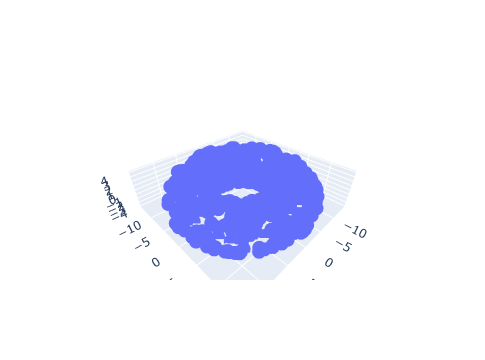

In [43]:
torus_points = sample_torus(500, R=10, r=4)

xj = [torus_points[i][0] for i in range(500)]
yj = [torus_points[i][1] for i in range(500)]
zj = [torus_points[i][2] for i in range(500)]

fig = go.Figure(data=[go.Scatter3d(x=xj,y=yj,z=zj, mode='markers')])
fig.show()

In [91]:
# Now try to sample from the genus 2 torus.
from scipy import optimize

def F(x,y,z,e):
    return (x*(x-1)**2*(x-2)+y**2)**2+z**2-e

def sample_g2torus(num_points, thickness=3):
    points = []
    x = np.random.uniform(low=-1,high=4, size =(num_points))
    y = np.random.uniform(low=-1,high=1, size =(num_points))
    for (xi,yi) in zip(x,y):
        #print(1,xi,yi)
        g= lambda z: F(xi,yi,z,0.01)
        res = optimize.fsolve(g, 1, full_output=1)
        if res[2] == 1:
            zii = res[0]
            zi = zii[0]
            points.append([xi,yi,zi])
    return points

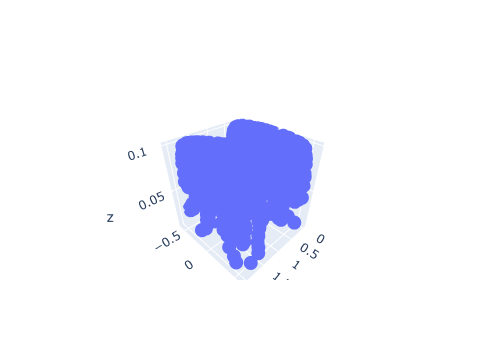

In [92]:

s = sample_g2torus(10000)

sx = [s[i][0] for i in range(len(s))]
sy = [s[i][1] for i in range(len(s))]
sz = [s[i][2] for i in range(len(s))]


fig2 = go.Figure(data=[go.Scatter3d(x=sx,y=sy,z=sz, mode='markers')])
fig2.show()